# KDD 2015

## Import Packages

In [1]:
import sys
sys.path.append('..')
from utilities import * 
from utilities.dataset_specific_utilities.kdd_2015 import *

## Dataset Preparation

### Import Data

In [2]:
import_interactions = ImportInteractionsKDD2015(DATASET_NAME,
                                                EVENT_FIELD,
                                                [PROBLEM_VALUE_STR, VIDEO_VALUE_STR],
                                                result_tables)
import_interactions.print_filter_results()
interactions = import_interactions.interactions.copy()

****************************************************************************************************


== Interactions Type Filter ==


Interactions Types: 
----------------------------------------------------------------------------------------------------
  Dataset Name Interactions Type  Interactions Count   Used
0     kdd_2015           problem             1261170   True
1     kdd_2015             video              796958   True
2     kdd_2015            access             3112191  False
3     kdd_2015        page_close             1237883  False
4     kdd_2015          navigate             1009309  False
5     kdd_2015        discussion              649259  False
6     kdd_2015              wiki               90507  False
----------------------------------------------------------------------------------------------------


Interactions Dataframe:
----------------------------------------------------------------------------------------------------
Input length: 8157277
Output lengt

### Transform Categorical Variable Values

In [3]:
interactions, value_mapping_df = map_new_to_old_values(interactions, 
                                                       GROUP_FIELD, 
                                                       USER_FIELD, 
                                                       LEARNING_ACTIVITY_FIELD)

### Filter Sequences by NAs in Dataset 

In [4]:
pct_na = get_nas_in_data(interactions)

****************************************************************************************************


enrollment_id                   0.0 %
time                            0.0 %
source                          0.0 %
event                           0.0 %
object                          0.0 %
username                        0.0 %
course_id                       0.0 %
is_dropout                      0.0 %
category         11.295361610162244 %
dtype: object


****************************************************************************************************


In [5]:
interactions, na_indices_list = drop_learning_activity_sequence_if_contains_na_in_field(interactions, 
                                                                                        GROUP_FIELD, 
                                                                                        USER_FIELD, 
                                                                                        field_list=[TIMESTAMP_FIELD,
                                                                                                    LEARNING_ACTIVITY_FIELD,
                                                                                                    DROPOUT_FIELD], 
                                                                                        field_value_tuple_filter_list=[])

****************************************************************************************************


Interactions Dataframe:
----------------------------------------------------------------------------------------------------
Input length: 2058128
Outpunt length: 2058128
Number of rows removed: 0
Percentage of rows removed: 0.0%
----------------------------------------------------------------------------------------------------
Input number of sequences: 79870
Output number of sequences: 79870
Number of sequences removed: 0
Percentage of sequences removed: 0.0%
----------------------------------------------------------------------------------------------------


****************************************************************************************************


In [6]:
interactions = drop_na_by_fields(interactions,
                                 field_list=[GROUP_FIELD,
                                             USER_FIELD])

****************************************************************************************************


Interactions Dataframe:
----------------------------------------------------------------------------------------------------
Input length: 2058128
Output length: 2058128
Number of rows removed: 0
Percentage of rows removed: 0%
----------------------------------------------------------------------------------------------------


****************************************************************************************************


In [7]:
pct_na = get_nas_in_data(interactions)

****************************************************************************************************


enrollment_id                   0.0 %
time                            0.0 %
source                          0.0 %
event                           0.0 %
object                          0.0 %
username                        0.0 %
course_id                       0.0 %
is_dropout                      0.0 %
category         11.295361610162244 %
dtype: object


****************************************************************************************************


### Sort by Timestamp

In [8]:
interactions = sort_by_timestamp(interactions,
                                 GROUP_FIELD,
                                 USER_FIELD,
                                 TIMESTAMP_FIELD,
                                 ORDER_FIELD)

### Evaluation Score Fields Ranges

In [9]:
return_and_plot_evaluation_score_range(interactions,
                                       LEARNING_ACTIVITY_FIELD,
                                       EVALUATION_LEARNING_ACTIVITY_SCORE_FIELD,
                                       GROUP_FIELD,
                                       EVALUATION_GROUP_SCORE_FIELD,
                                       EVALUATION_COURSE_SCORE_FIELD,
                                       result_tables)

### Transform Data

In [10]:
transform_interactions = TransformInteractionsKDD2015(interactions)
interactions = transform_interactions.interactions.copy()

### Add Evaluation Fields

In [11]:
interactions = add_evaluation_fields(interactions,
                                     GROUP_FIELD,
                                     USER_FIELD,
                                     LEARNING_ACTIVITY_FIELD,
                                     TIMESTAMP_FIELD,
                                     ORDER_FIELD,
                                     EVALUATION_GROUP_SCORE_FIELD,
                                     EVALUATION_GROUP_IS_CORRECT_FIELD,
                                     EVALUATION_COURSE_SCORE_FIELD,
                                     EVALUATION_COURSE_IS_CORRECT_FIELD,
                                     ADD_EVALUATION_GROUP_IS_CORRECT_FIELD,
                                     ADD_EVALUATION_COURSE_IS_CORRECT_FIELD,
                                     EVALUATION_GROUP_SCORE_CORRECT_THRESHOLD,
                                     EVALUATION_COURSE_SCORE_CORRECT_THRESHOLD,
                                     operator.gt,
                                     operator.gt,
                                     calculate_eval_metrics)

100%|██████████| 79870/79870 [00:03<00:00, 22257.77it/s]


****************************************************************************************************


= Repeated Consecutive Learning Activity Removal =


Initial number of rows: 2058128
Final number of rows: 1016073
Removed number of rows: 1042055
Removed percentage of rows: 50.63120466754254%


****************************************************************************************************


### Rename Fields

In [12]:
interactions, fields_mapping_df = rename_fields(interactions,
                                                GROUP_FIELD,
                                                USER_FIELD,
                                                LEARNING_ACTIVITY_FIELD,
                                                TIMESTAMP_FIELD)

### Add Sequence ID Field

In [13]:
interactions = add_sequence_id_field(interactions,
                                     GROUP_FIELD)

### Filter Sequences


****************************************************************************************************
****************************************************************************************************

!!! Sequence Preprocessing 1st Step !!!

Sequence Filtering based on:

Minimum "% of Unique Learning Resources per Topic in Sequence": 50%
Maximum "Repeated Learning Resources in Sequence %": 80%



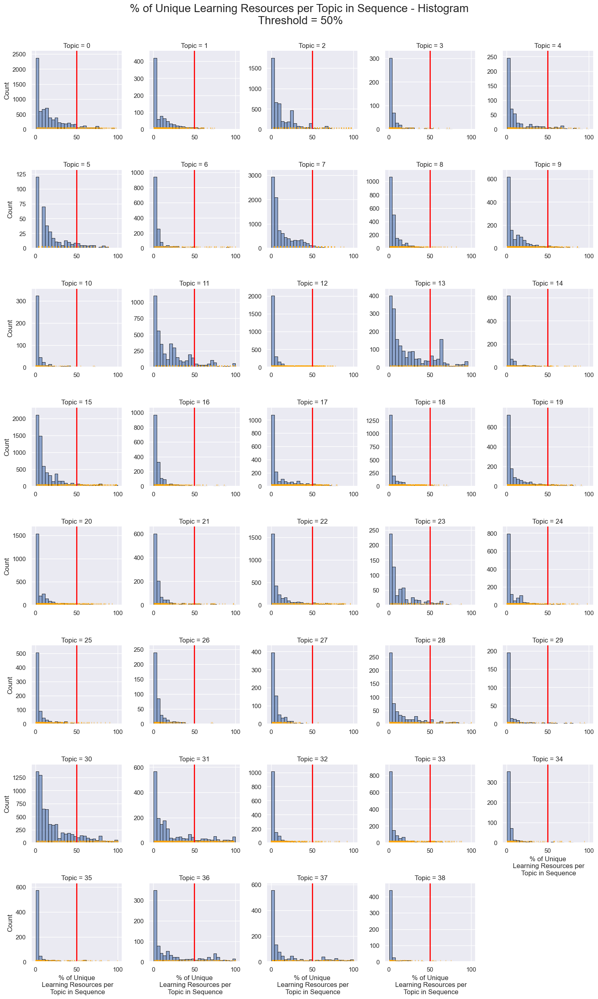

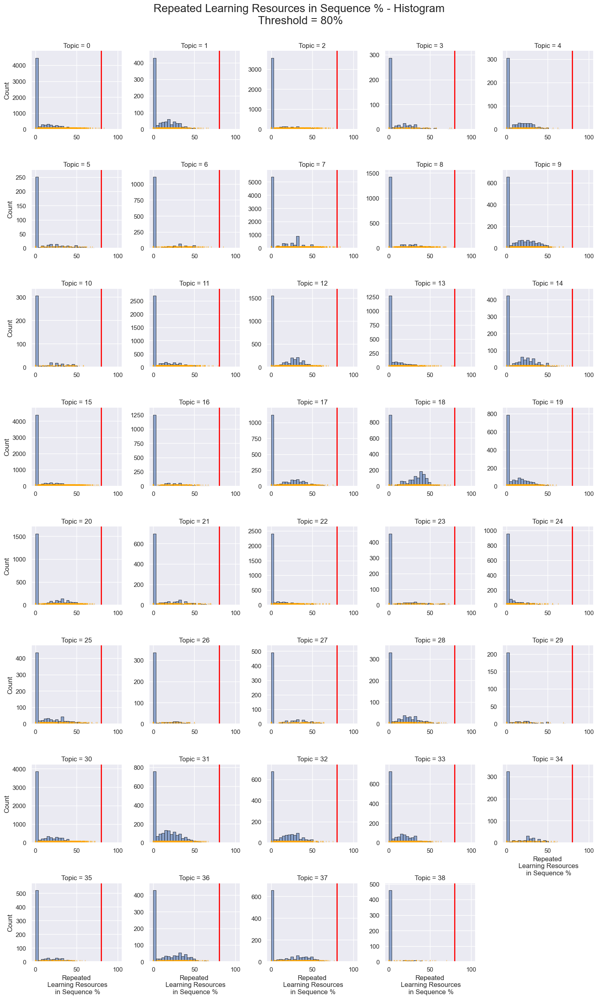


== Interactions Dataframe: ==
----------------------------------------------------------------------------------------------------
Number of rows before filter: 1016073
Number of rows after filter: 345756
Number of rows removed: 670317
Percentage of rows removed: 65.97134261022583%
----------------------------------------------------------------------------------------------------

== Sequence Counts per Topic: ==
----------------------------------------------------------------------------------------------------
   Dataset Name  Topic             Count Type    OG  1st PP
0      kdd_2015      0         Sequence Count  7213     721
1      kdd_2015      1         Sequence Count   852      34
2      kdd_2015      2         Sequence Count  4872     319
3      kdd_2015      3         Sequence Count   455       7
4      kdd_2015      4         Sequence Count   538      51
5      kdd_2015      5         Sequence Count   378      40
6      kdd_2015      6         Sequence Count  1498      42


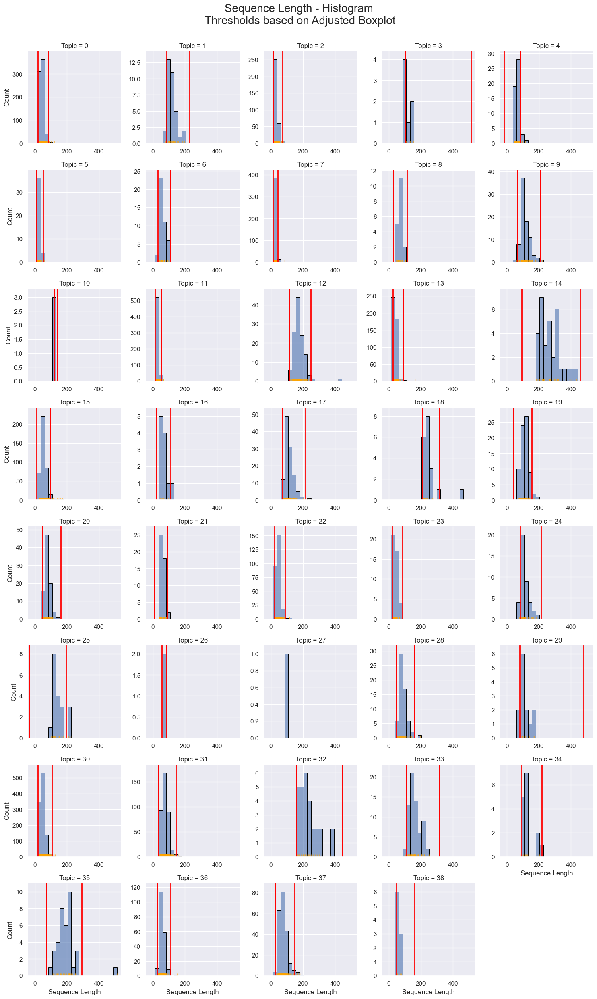


== Interactions Dataframe: ==
----------------------------------------------------------------------------------------------------
Number of rows before filter: 345756
Number of rows after filter: 335361
Number of rows removed: 10395
Percentage of rows removed: 3.0064554194287303%
----------------------------------------------------------------------------------------------------

== Sequence Counts per Topic: ==
----------------------------------------------------------------------------------------------------
   Dataset Name  Topic             Count Type    OG  1st PP  2nd PP
0      kdd_2015      0         Sequence Count  7213     721     715
1      kdd_2015      1         Sequence Count   852      34      32
2      kdd_2015      2         Sequence Count  4872     319     318
3      kdd_2015      3         Sequence Count   455       7       6
4      kdd_2015      4         Sequence Count   538      51      47
5      kdd_2015      5         Sequence Count   378      40      39
6    

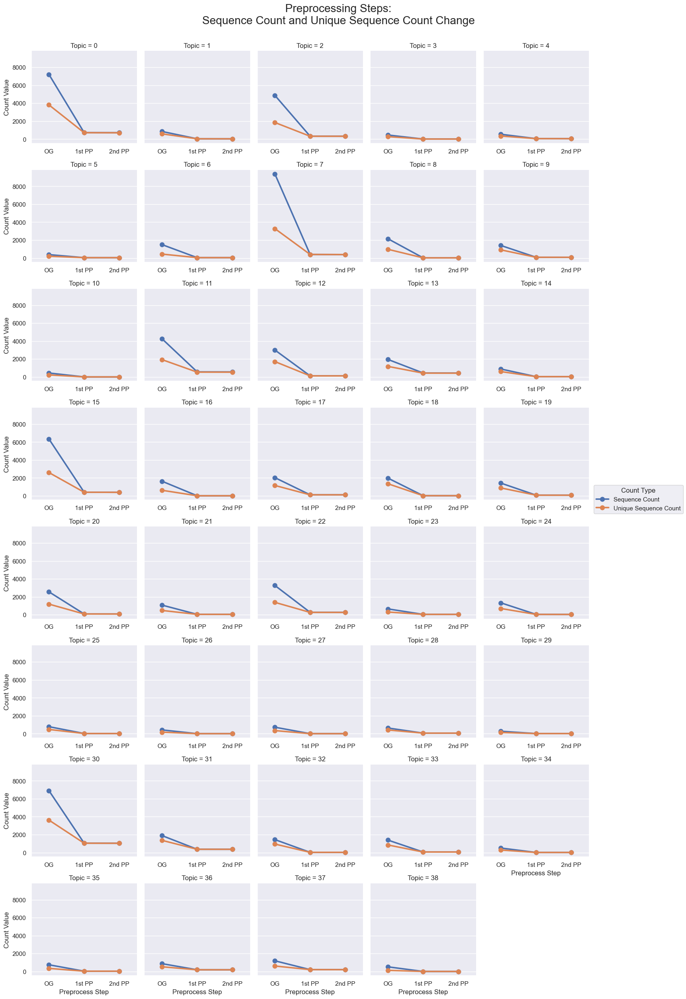


****************************************************************************************************
****************************************************************************************************

!!! Sequence Preprocessing 3rd Step !!!

Topic Filtering based on:

Sequence Count Threshold: 100
Unique Sequence Count Threshold: 25



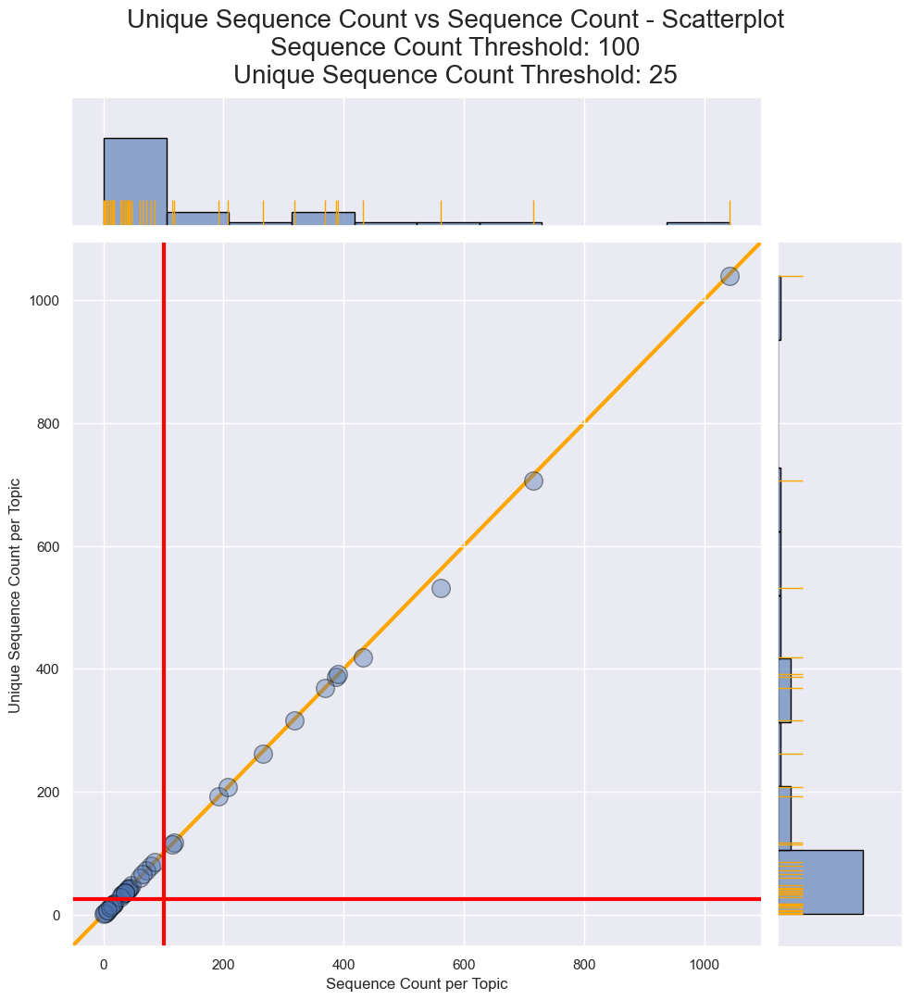


== Interactions Dataframe: ==
----------------------------------------------------------------------------------------------------
Number of rows before filter: 335361
Number of rows after filter: 243169
Number of rows removed: 92192
Percentage of rows removed: 27.49037604253327%
----------------------------------------------------------------------------------------------------

== Sequence Counts per Topic: ==
----------------------------------------------------------------------------------------------------
   Dataset Name  Topic             Count Type    OG  1st PP  2nd PP  3rd PP
0      kdd_2015      0         Sequence Count  7213     721     715     715
1      kdd_2015      1         Sequence Count   852      34      32    <NA>
2      kdd_2015      2         Sequence Count  4872     319     318     318
3      kdd_2015      3         Sequence Count   455       7       6    <NA>
4      kdd_2015      4         Sequence Count   538      51      47    <NA>
5      kdd_2015      5    

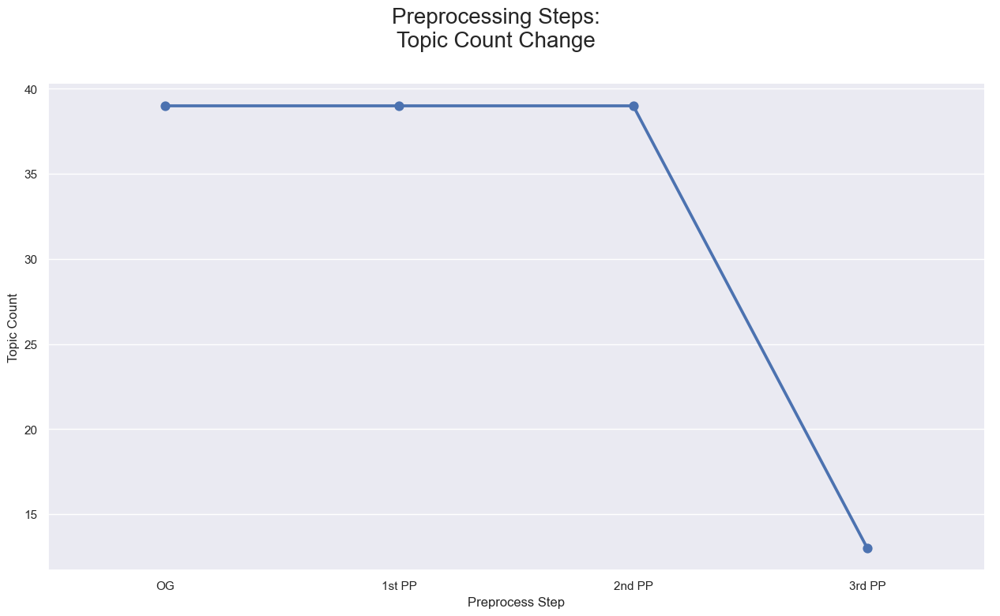

In [14]:
sequence_filter = SequenceFilter(DATASET_NAME,
                                 interactions,
                                 GROUP_FIELD,
                                 50,
                                 80,
                                 100,
                                 25)
sequence_filter.filter_sequences(result_tables)
interactions = sequence_filter.interactions.copy()

### Add Averaged Evaluation Field

In [15]:
interactions = add_evaluation_fields_average(interactions,
                                             GROUP_FIELD,
                                             np.mean)

### Check Dataset

In [16]:
interactions.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 243169 entries, 0 to 243168
Data columns (total 86 columns):
 #   Column                                                                                   Non-Null Count   Dtype         
---  ------                                                                                   --------------   -----         
 0   Timestamp                                                                                243169 non-null  datetime64[ns]
 1   User                                                                                     243169 non-null  int64         
 2   Topic                                                                                    243169 non-null  int64         
 3   Learning Resource                                                                        243169 non-null  int64         
 4   Sequence ID                                                                              243169 non-null  int64         
 5   Le

In [17]:
pct_na = get_nas_in_data(interactions)
pct_na

****************************************************************************************************


Timestamp                                                                                    0.0 %
User                                                                                         0.0 %
Topic                                                                                        0.0 %
Learning Resource                                                                            0.0 %
Sequence ID                                                                                  0.0 %
Learning Resource Interactions Total                                                         0.0 %
Learning Resource Attempts Total                                                             0.0 %
Learning Resource Hints Total                                                              100.0 %
Learning Resource Time in Seconds Total                                                    100.0 %
Learni

### Save the Dataset and Mapping Information, Add Interactions to ResultTables

In [18]:
save_interaction_and_mapping_df(interactions,
                                fields_mapping_df,
                                value_mapping_df,
                                PATH_TO_CLEANED_DATASETS,
                                DATASET_NAME)

In [19]:
result_tables.interactions = interactions

## Dataset Characteristics

### Dataset Information

---
**Has GROUPING Field:** True

---
**Available Evaluation Metrics**  
Possible Values: 
>- True 
>- False
>- Derived (For 'Is Correct' fields)

Score Threshold to be correct:   
>    Learning Activity Is Correct Threshold:  
>    Group Is Correct Threshold:  
>    Course Is Correct Threshold:  

>**I. Learning Activity Level**:

- **Number of Interactions Total:**

- **Number of Attempts Total:**

- **Number of Hints Total:**

- **Score Highest:**

- **Score Highest without Hint:**

- **Score First Attempt:**

- **Score Last Attempt:**

- **Number of Interactions until Highest Score:**

- **Number of Attempts until Highest Score:**

- **Number of Hints until Highest Score:**

- **Is Correct:** Derived
        
- **Is Correct without Hint:**

- **Is Correct at First Attempt:**

- **Is Correct at First Attempt without Hint:**
        
- **Is Correct at Last Attempt :**

- **Is Correct at Last Attempt without Hint:**

- **Number of Interactions until Correct:**

- **Number of Attempts until Correct:**

- **Number of Hints until Correct:**


>**II. Group level**:

- **Group Score:**

- **Group Is Correct:**


>**III. Course level**:

- **Course Score:** True  
Final grades of course

- **Course Is Correct:** False

---
**Additional Information:**

- Objects.csv containt information about object hierarchy -> worth taking a closer look into it

- Evaluations are approximated by dropouts

- Focus on certain events: problems, videos(maybe)

### Available Fields

In [20]:
result_tables.display_available_fields()

<table border="1" class="dataframe">
 <thead>
  <tr>
   <th style="background-color: royalblue; color: white; text-align:center">
    Field
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    Is Available
   </th>
  </tr>
  <tr>
   <th style="background-color: royalblue; color: white; text-align:center">
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    kdd_2015
   </th>
  </tr>
 </thead>
 <tbody>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Timestamp
   </th>
   <td style="background-color: green; color: white; text-align:center">
    True
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    User
   </th>
   <td style="background-color: green; color: white; text-align:center">
    True
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic
   </th>
   <td style="background-color: green; color: white; text-align:center">
    True
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource
   </th>
   <td style="background-color: green; color: white; text-align:center">
    True
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Sequence ID
   </th>
   <td style="background-color: green; color: white; text-align:center">
    True
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Interactions Total
   </th>
   <td style="background-color: green; color: white; text-align:center">
    True
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Attempts Total
   </th>
   <td style="background-color: green; color: white; text-align:center">
    True
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Hints Total
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Time in Seconds Total
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Single Score
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Single Score (Hint Taken Equals Lowest Score)
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Single Score (Not First Attempt Equals Lowest Score)
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Highest Score
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Highest Score Without Hint
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource First Attempt Score
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Last Attempt Score
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Interactions Until Highest Score
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Attempts Until Highest Score
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Hints Until Highest Score
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Time in Seconds Until Highest Score
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Is Correct
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Is Correct Without Hints
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource First Attempt Is Correct
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource First Attempt Is Correct Without Hints
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Last Attempt Is Correct
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Last Attempt Is Correct Without Hints
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Interactions Until Correct
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Attempts Until Correct
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Hints Until Correct
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource Time in Seconds Until Correct
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Score
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Is Correct
   </th>
   <td style="background-color: green; color: white; text-align:center">
    True
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Score
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Is Correct
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Interactions Total All Learning Resources Mean
   </th>
   <td style="background-color: green; color: white; text-align:center">
    True
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Attempts Total All Learning Resources Mean
   </th>
   <td style="background-color: green; color: white; text-align:center">
    True
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Hints Total All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Time in Seconds Total All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Single Score All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Single Score (Hint Taken Equals Lowest Score) All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Single Score (Not First Attempt Equals Lowest Score) All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Highest Score All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Highest Score Without Hint All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic First Attempt Score All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Last Attempt Score All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Interactions Until Highest Score All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Attempts Until Highest Score All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Hints Until Highest Score All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Time in Seconds Until Highest Score All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Is Correct All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Is Correct Without Hints All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic First Attempt Is Correct All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic First Attempt Is Correct Without Hints All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Last Attempt Is Correct All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Last Attempt Is Correct Without Hints All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Interactions Until Correct All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Attempts Until Correct All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Hints Until Correct All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic Time in Seconds Until Correct All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Interactions Total All Learning Resources Mean
   </th>
   <td style="background-color: green; color: white; text-align:center">
    True
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Attempts Total All Learning Resources Mean
   </th>
   <td style="background-color: green; color: white; text-align:center">
    True
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Hints Total All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Time in Seconds Total All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Single Score All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Single Score (Hint Taken Equals Lowest Score) All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Single Score (Not First Attempt Equals Lowest Score) All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Highest Score All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Highest Score Without Hint All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course First Attempt Score All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Last Attempt Score All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Interactions Until Highest Score All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Attempts Until Highest Score All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Hints Until Highest Score All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Time in Seconds Until Highest Score All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Is Correct All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Is Correct Without Hints All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course First Attempt Is Correct All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course First Attempt Is Correct Without Hints All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Last Attempt Is Correct All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Last Attempt Is Correct Without Hints All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Interactions Until Correct All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Attempts Until Correct All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Hints Until Correct All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Time in Seconds Until Correct All Learning Resources Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Score All Topics Mean
   </th>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course Is Correct All Topics Mean
   </th>
   <td style="background-color: green; color: white; text-align:center">
    True
   </td>
  </tr>
 </tbody>
</table>


### Score - Is_Correct Relationship

In [21]:
result_tables.display_score_is_correct_relationship()

<table border="1" class="dataframe">
 <thead>
  <tr style="text-align: right;">
   <th style="background-color: royalblue; color: white; text-align:center">
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    Has Field
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    Has Score Field
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    Has Is_Correct Field
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    Chosen Score Is_Correct Threshold
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    Score Minimum In Documentation
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    Score Maximum In Documentation
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    Score Minimum in Data Identical Over Evaluation Elements
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    Score Maximum in Data Identical Over Evaluation Elements
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    Score Minimum in Data
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    Score Maximum in Data
   </th>
  </tr>
 </thead>
 <tbody>
  <tr>
   <th rowspan="3" style="background-color: rgb(80, 80, 80); color: white; text-align:left" valign="top">
    kdd_2015
   </th>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Learning Resource
   </th>
   <td style="background-color: green; color: white; text-align:center">
    True
   </td>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Topic
   </th>
   <td style="background-color: green; color: white; text-align:center">
    True
   </td>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
   <td style="background-color: green; color: white; text-align:center">
    True
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
  </tr>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    Course
   </th>
   <td style="background-color: green; color: white; text-align:center">
    True
   </td>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
   <td style="background-color: red; color: white; text-align:center">
    False
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
   <td style="color: white; text-align:center">
    -
   </td>
  </tr>
 </tbody>
</table>


### Summary Statistics

In [22]:
result_tables.display_summary_statistics()

<table border="1" class="dataframe">
 <thead>
  <tr style="text-align: right;">
   <th style="background-color: royalblue; color: white; text-align:center">
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    # of Rows
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    # of Unique Users
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    # of Unique Topics
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    # of Unique Learning Resources
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    Sparsity User-Learning Resource Matrix %
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    Sparsity User-Topic Matrix %
   </th>
  </tr>
 </thead>
 <tbody>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    kdd_2015
   </th>
   <td style="background-color: rgb(0, 0, 204); color: white; text-align:center">
    243169
   </td>
   <td style="background-color: rgb(0, 0, 204); color: white; text-align:center">
    4643
   </td>
   <td style="background-color: rgb(0, 0, 204); color: white; text-align:center">
    13
   </td>
   <td style="background-color: rgb(0, 0, 204); color: white; text-align:center">
    828
   </td>
   <td style="background-color: rgb(0, 0, 204); color: white; text-align:center">
    95.35
   </td>
   <td style="background-color: rgb(0, 0, 204); color: white; text-align:center">
    91.53
   </td>
  </tr>
 </tbody>
</table>


### Sequence Summary Statistics

In [23]:
result_tables.display_sequence_statistics()

<table border="1" class="dataframe">
 <thead>
  <tr style="text-align: right;">
   <th style="background-color: royalblue; color: white; text-align:center">
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    # of Sequences
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    # of Unique Sequences
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    Mean Sequence Length
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    Median Sequence Length
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    Standard Deviation Sequence Length
   </th>
   <th style="background-color: royalblue; color: white; text-align:center">
    IQR Sequence Length
   </th>
  </tr>
 </thead>
 <tbody>
  <tr>
   <th style="background-color: rgb(80, 80, 80); color: white; text-align:left">
    kdd_2015
   </th>
   <td style="background-color: rgb(0, 0, 204); color: white; text-align:center">
    5111
   </td>
   <td style="background-color: rgb(0, 0, 204); color: white; text-align:center">
    5048
   </td>
   <td style="background-color: rgb(0, 0, 204); color: white; text-align:center">
    47.58
   </td>
   <td style="background-color: rgb(0, 0, 204); color: white; text-align:center">
    40.0
   </td>
   <td style="background-color: rgb(0, 0, 204); color: white; text-align:center">
    29.39
   </td>
   <td style="background-color: rgb(0, 0, 204); color: white; text-align:center">
    40.0
   </td>
  </tr>
 </tbody>
</table>


## Group-User-Learning_Activity Relationship

****************************************************************************************************
****************************************************************************************************


----------------------------------------------------------------------------------------------------
Number of Learning Resources per User (Rows per User):
----------------------------------------------------------------------------------------------------
mean: number of Learning Resources per User: 52.373250053844494
median: number of Learning Resources per User: 41.0
max: number of Learning Resources per User: 536
min: number of Learning Resources per User: 14
std: number of Learning Resources per User: 37.18170434229269
iqr: number of Learning Resources per User: 30.0


Plots:


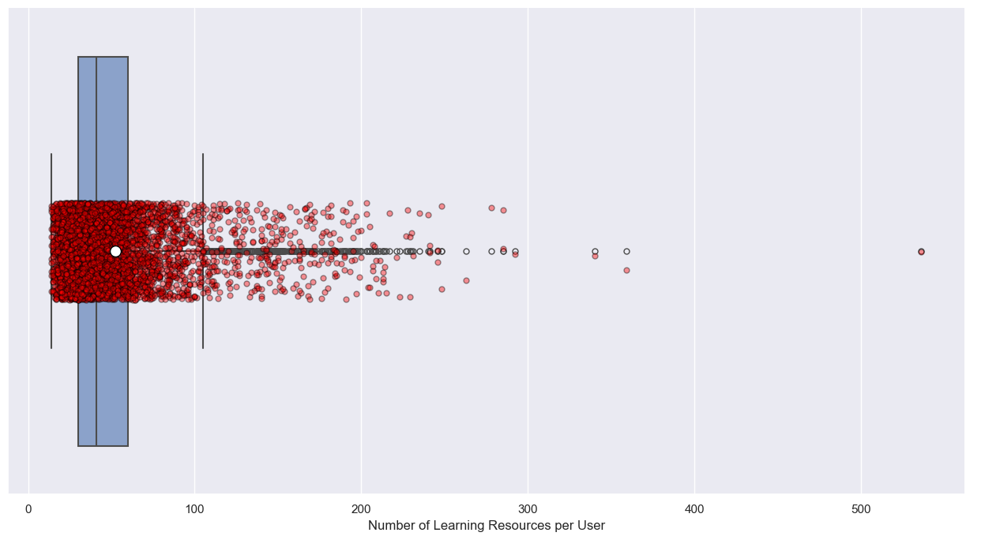

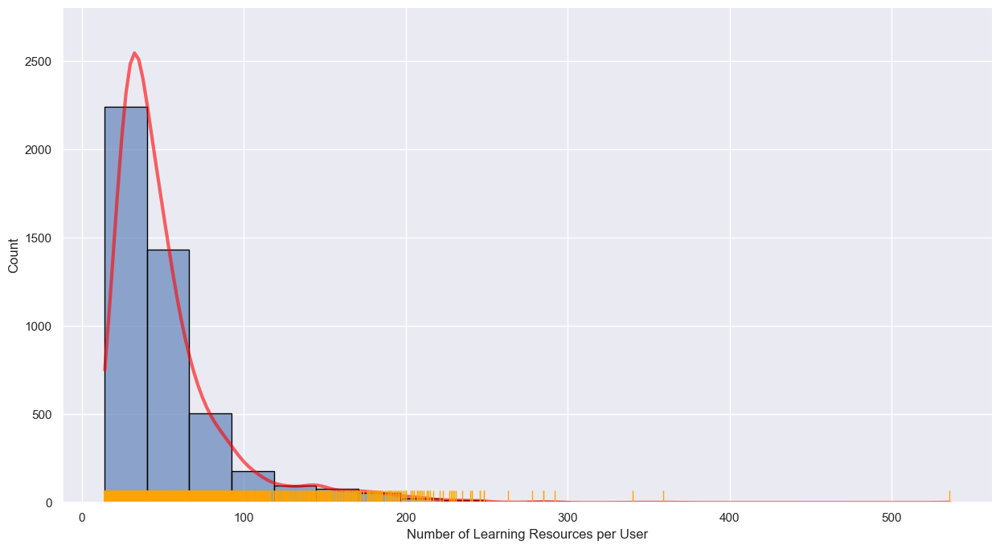

****************************************************************************************************
****************************************************************************************************
----------------------------------------------------------------------------------------------------
Number of Unique Topics per User:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Topics per User: 1.1007968985569674
median: Number of Unique Topics per User: 1.0
max: Number of Unique Topics per User: 7
min: Number of Unique Topics per User: 1
std: Number of Unique Topics per User: 0.3732858428047889
iqr: Number of Unique Topics per User: 0.0


Plots:


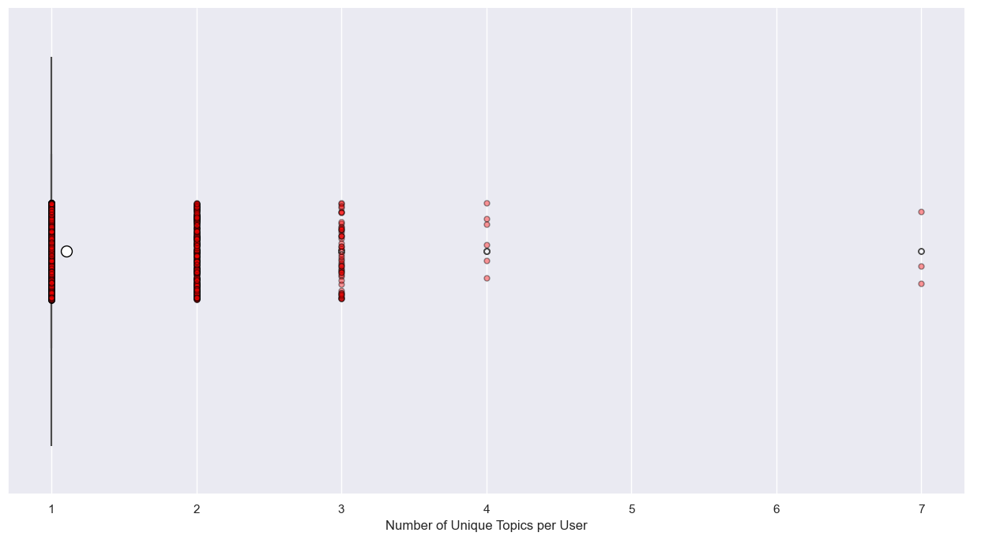

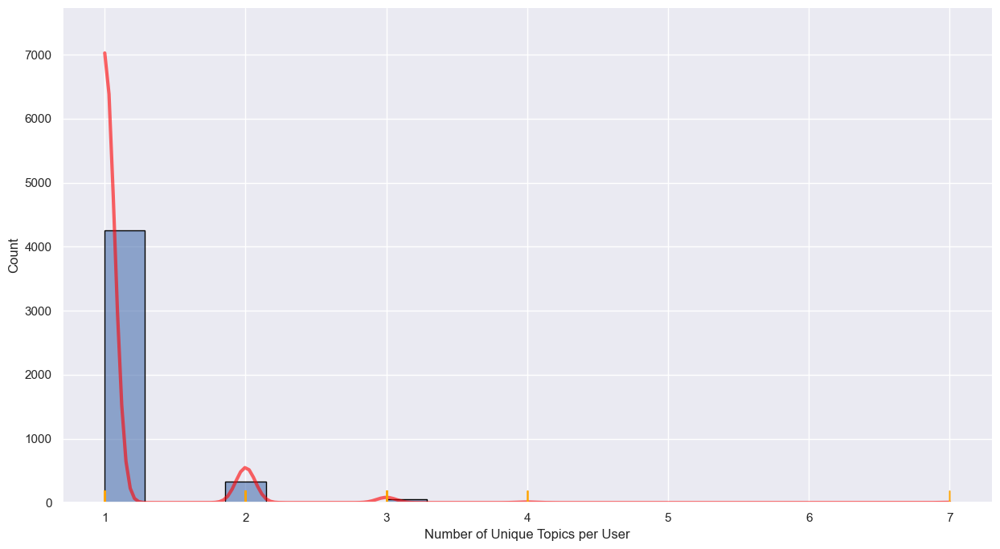

****************************************************************************************************
****************************************************************************************************


----------------------------------------------------------------------------------------------------
Number of Unique Learning Resources per User:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Learning Resources per User: 38.46693947878527
median: Number of Unique Learning Resources per User: 31.0
max: Number of Unique Learning Resources per User: 379
min: Number of Unique Learning Resources per User: 13
std: Number of Unique Learning Resources per User: 25.058078488709242
iqr: Number of Unique Learning Resources per User: 18.0


Plots:


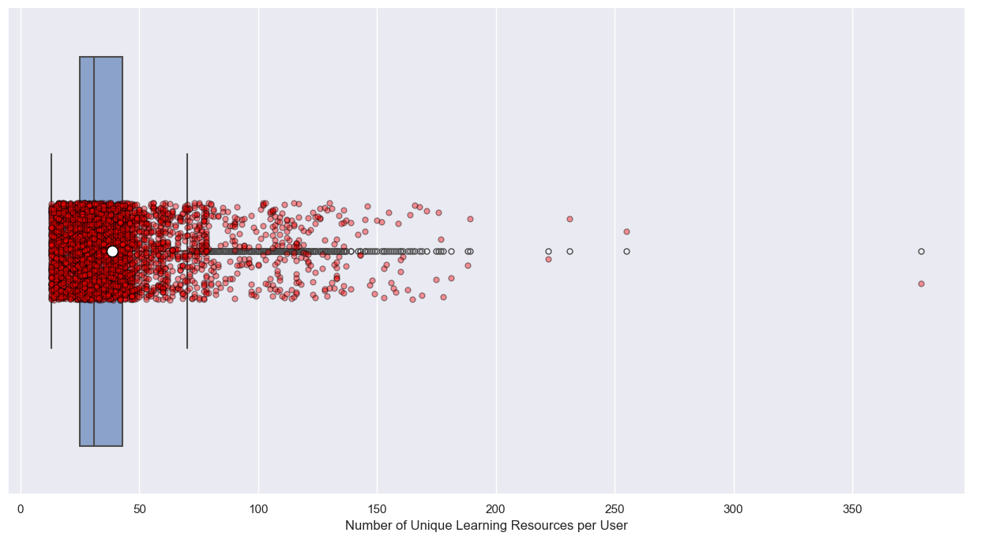

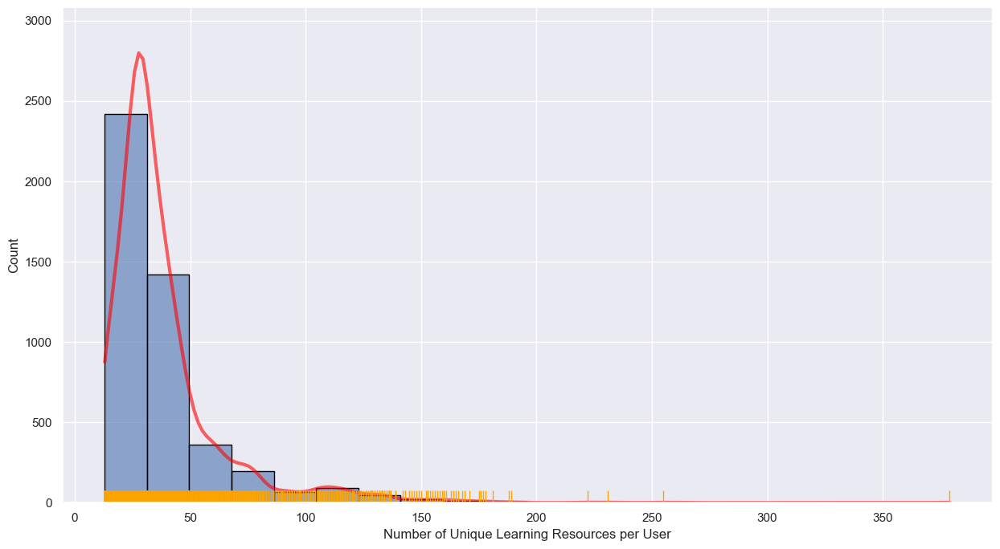

****************************************************************************************************
****************************************************************************************************


----------------------------------------------------------------------------------------------------
Number of Unique Users per Topic:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Users per Topic: 393.15384615384613
median: Number of Unique Users per Topic: 369.0
max: Number of Unique Users per Topic: 1042
min: Number of Unique Users per Topic: 114
std: Number of Unique Users per Topic: 259.1675282366749
iqr: Number of Unique Users per Topic: 225.0


Plots:


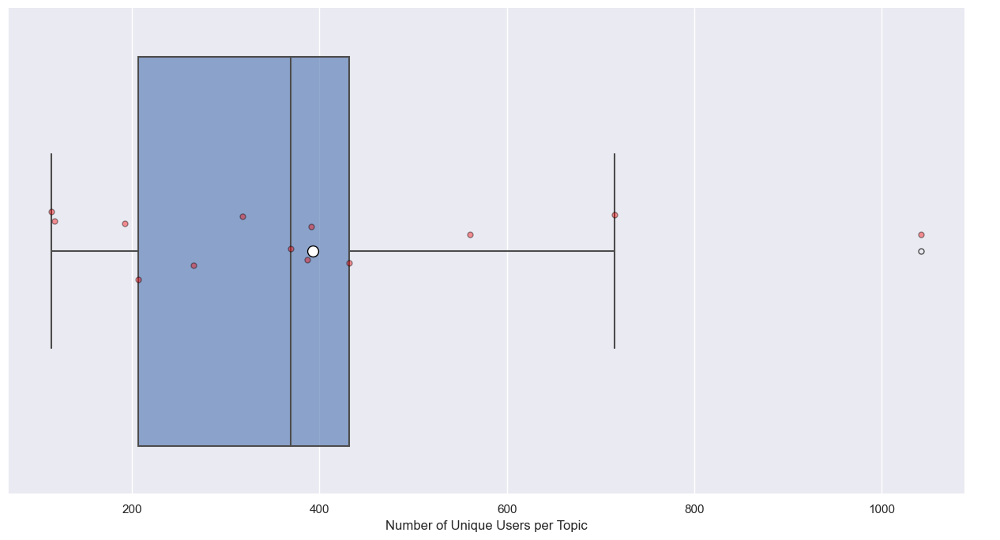

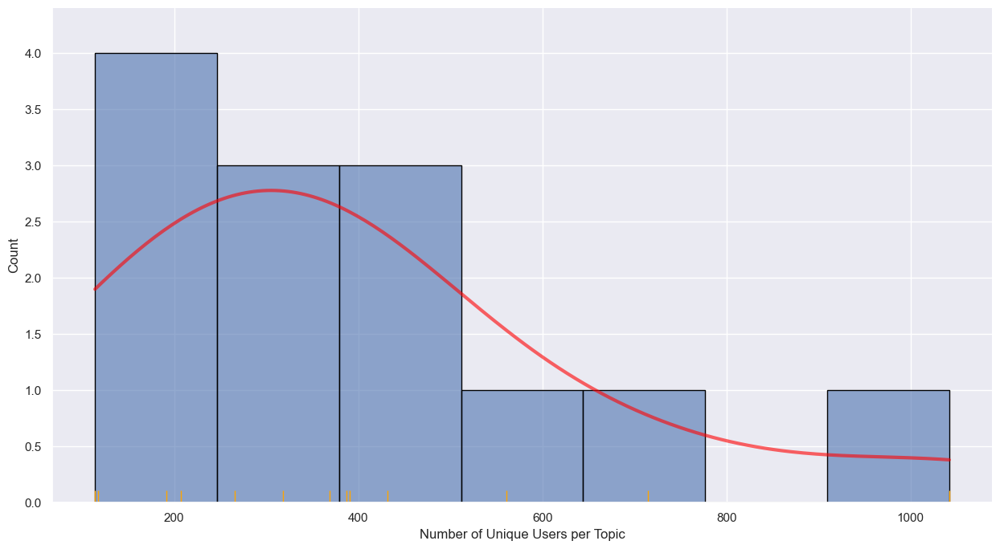

****************************************************************************************************
****************************************************************************************************


----------------------------------------------------------------------------------------------------
Number of Unique Learning Resources per Topic:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Learning Resources per Topic: 64.61538461538461
median: Number of Unique Learning Resources per Topic: 51.0
max: Number of Unique Learning Resources per Topic: 199
min: Number of Unique Learning Resources per Topic: 25
std: Number of Unique Learning Resources per Topic: 45.558640712709405
iqr: Number of Unique Learning Resources per Topic: 13.0


Plots:


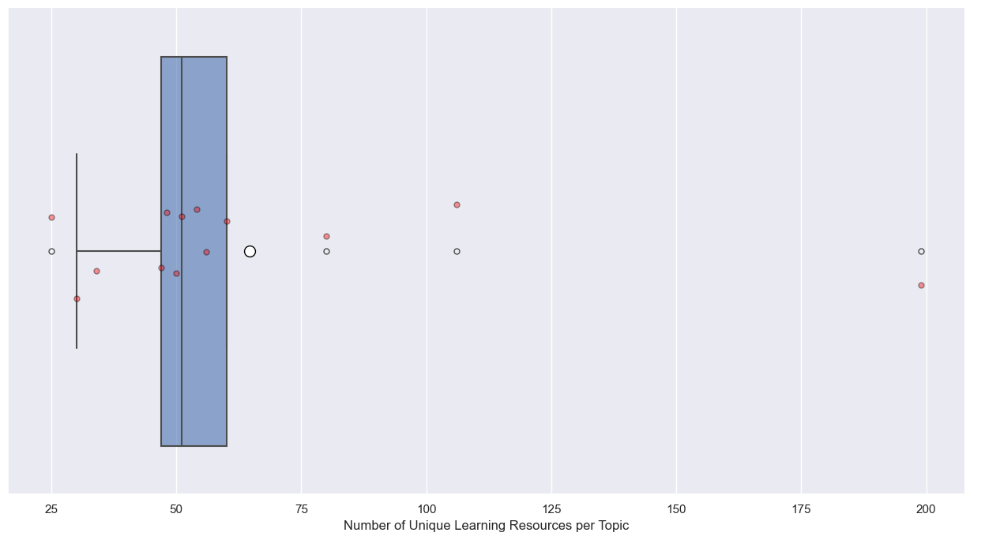

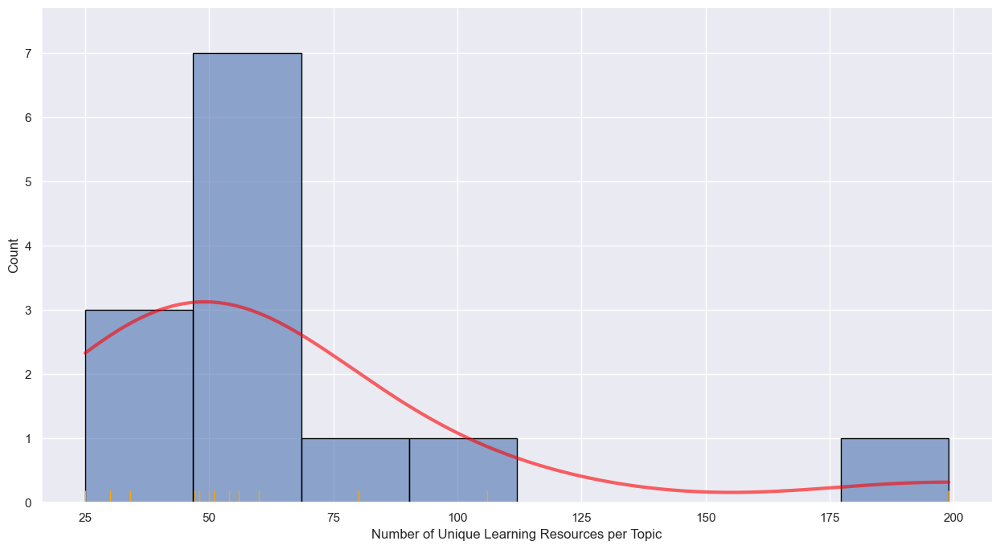

****************************************************************************************************
****************************************************************************************************


----------------------------------------------------------------------------------------------------
Number of Unique Users per Learning Resource:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Users per Learning Resource: 215.70289855072463
median: Number of Unique Users per Learning Resource: 129.0
max: Number of Unique Users per Learning Resource: 1387
min: Number of Unique Users per Learning Resource: 1
std: Number of Unique Users per Learning Resource: 209.9492623483899
iqr: Number of Unique Users per Learning Resource: 225.5


Plots:


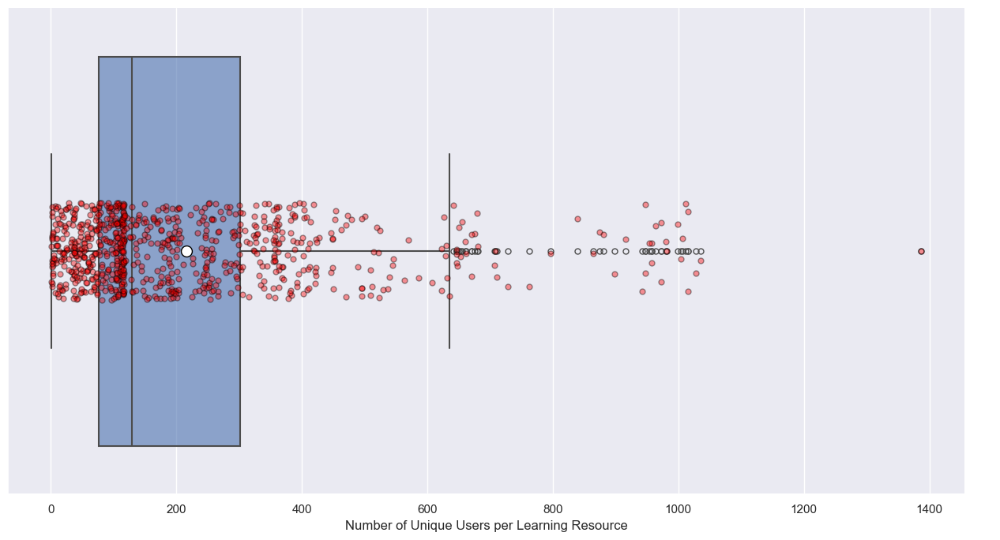

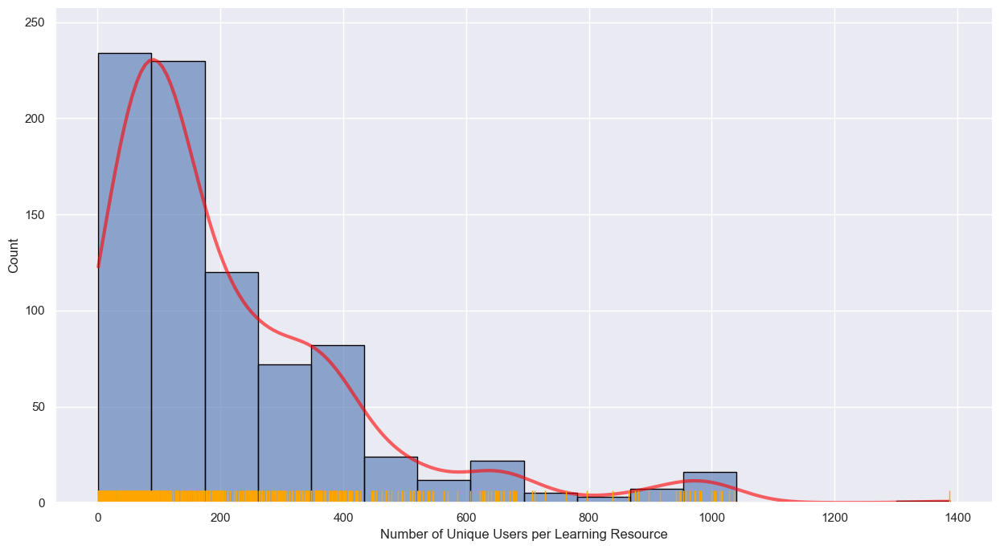

****************************************************************************************************
****************************************************************************************************


----------------------------------------------------------------------------------------------------
Number of Unique Topics per Learning Resource:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Topics per Learning Resource: 1.0144927536231885
median: Number of Unique Topics per Learning Resource: 1.0
max: Number of Unique Topics per Learning Resource: 13
min: Number of Unique Topics per Learning Resource: 1
std: Number of Unique Topics per Learning Resource: 0.41702882811415326
iqr: Number of Unique Topics per Learning Resource: 0.0


Plots:


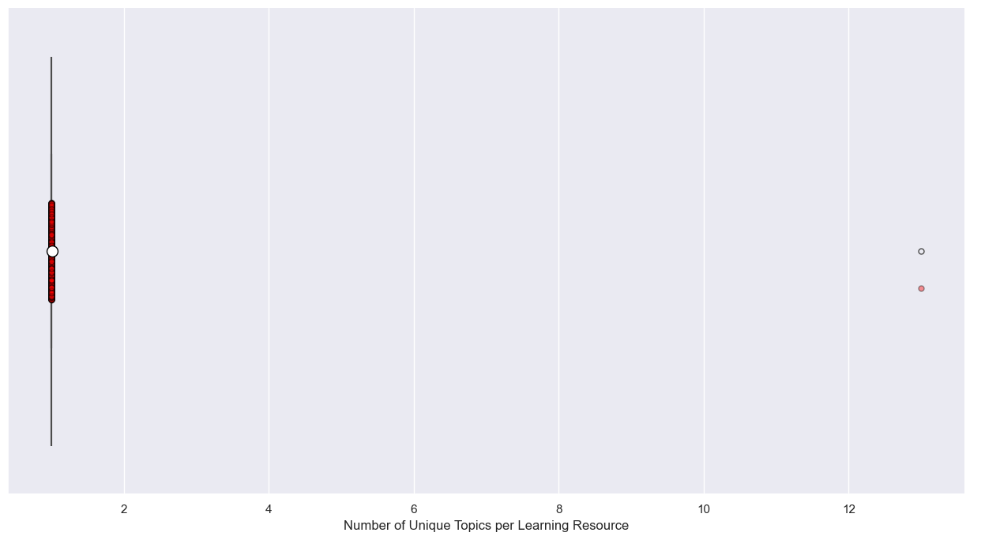

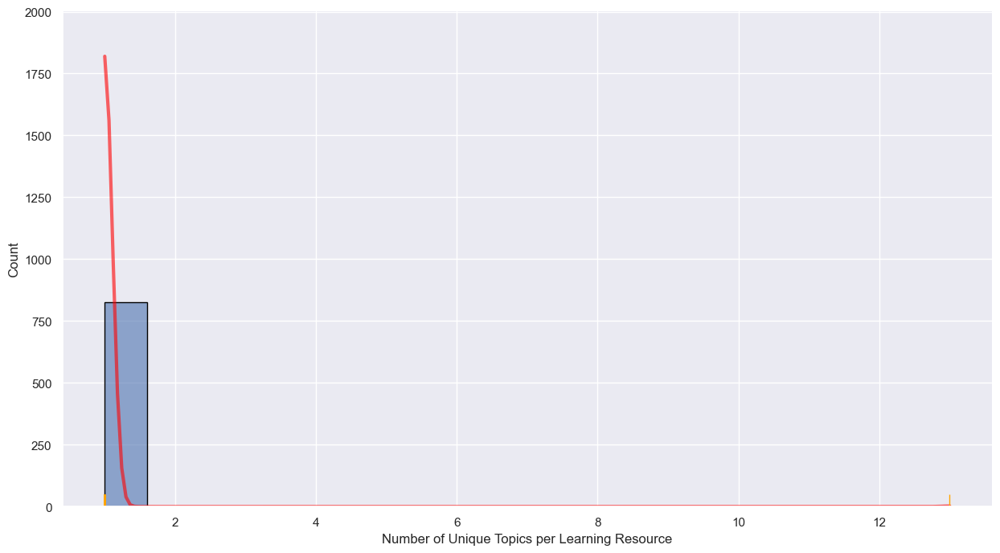

****************************************************************************************************
****************************************************************************************************


----------------------------------------------------------------------------------------------------
Mean/Median Number of Learning Resources (Rows) per Topic for a User:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Learning Resources per Topic for a User: 47.195817051783024
median of Mean Number of Learning Resources per Topic for a User: 40.0
max of Mean Number of Learning Resources per Topic for a User: 240.0
min of Mean Number of Learning Resources per Topic for a User: 14.0
std of Mean Number of Learning Resources per Topic for a User: 28.59094545671999
iqr of Mean Number of Learning Resources per Topic for a User: 26.0

-----------------------------------------------------------------------------------

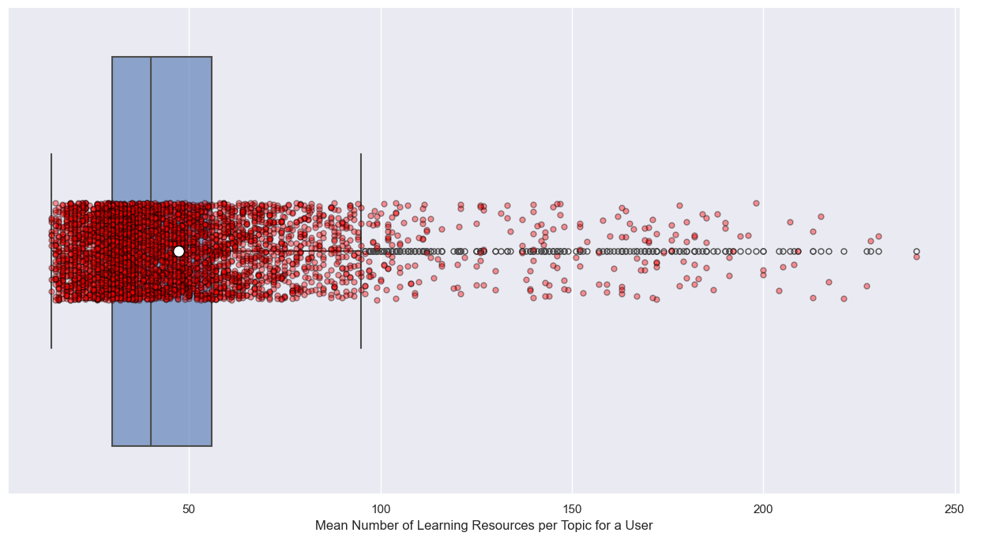

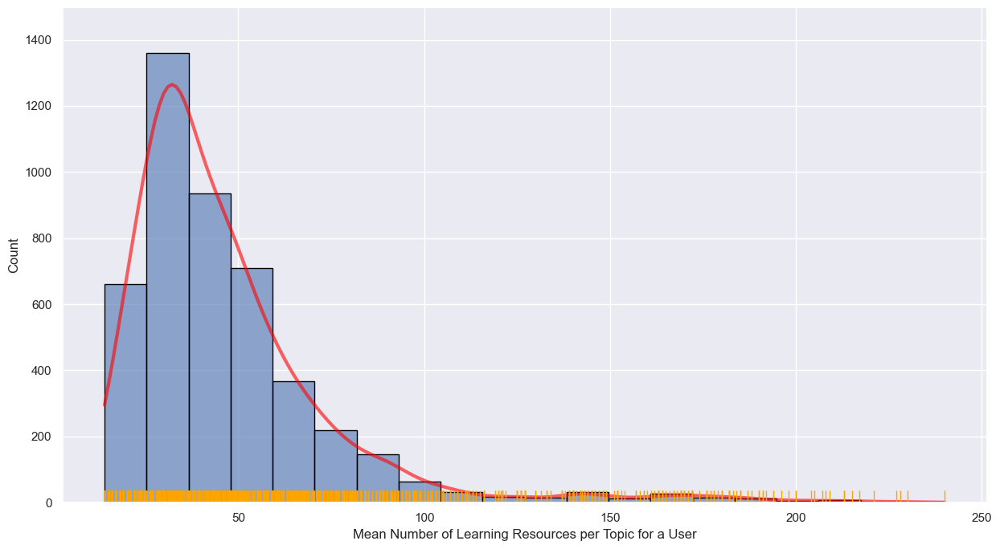



Median:


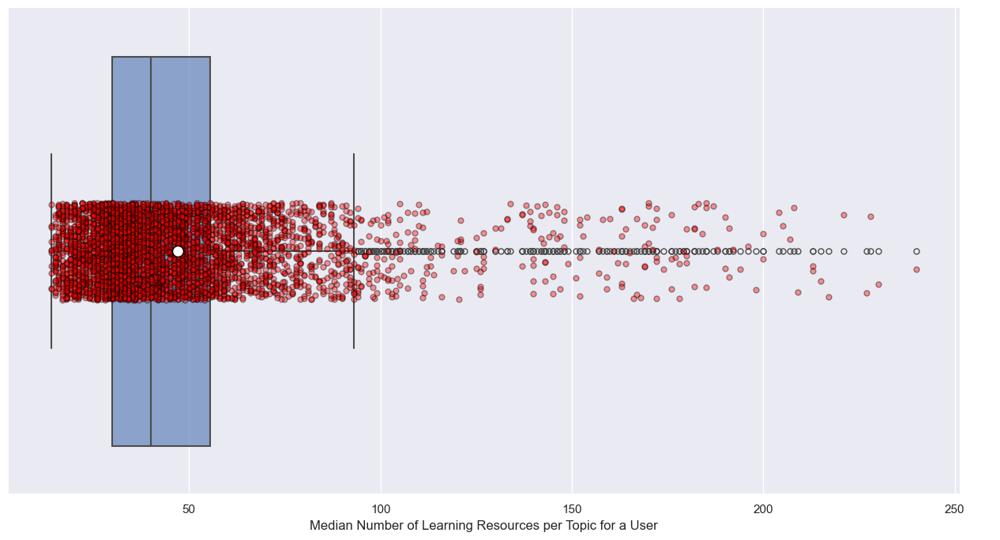

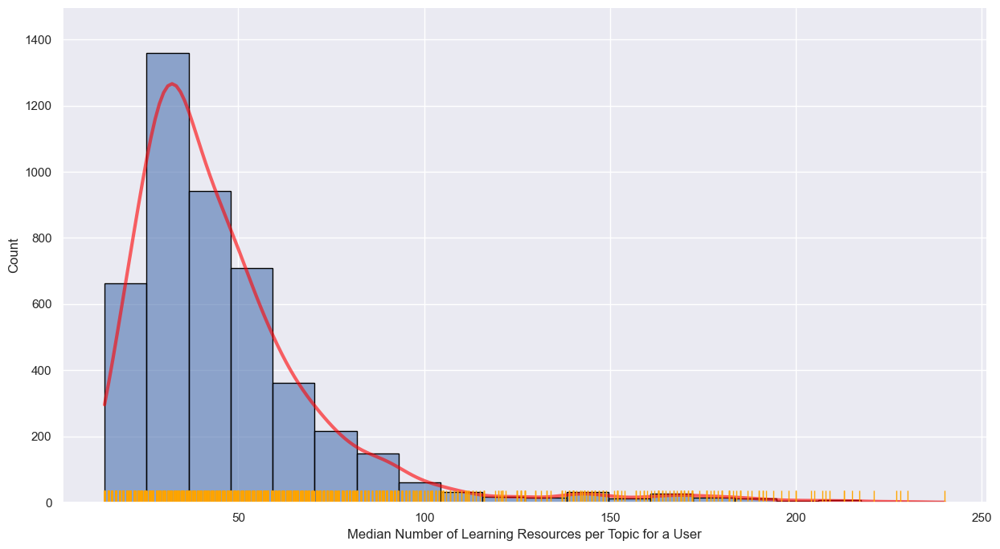

****************************************************************************************************
****************************************************************************************************


----------------------------------------------------------------------------------------------------
Mean/Median Number of Learning Resources (Rows) per User for a Topic:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Learning Resources per User for a Topic: 60.32594135764977
median of Mean Number of Learning Resources per User for a Topic: 45.67658349328215
max of Mean Number of Learning Resources per User for a Topic: 172.2136752136752
min of Mean Number of Learning Resources per User for a Topic: 21.96124031007752
std of Mean Number of Learning Resources per User for a Topic: 41.45895157910044
iqr of Mean Number of Learning Resources per User for a Topic: 35.94816827697262

---------------------------------

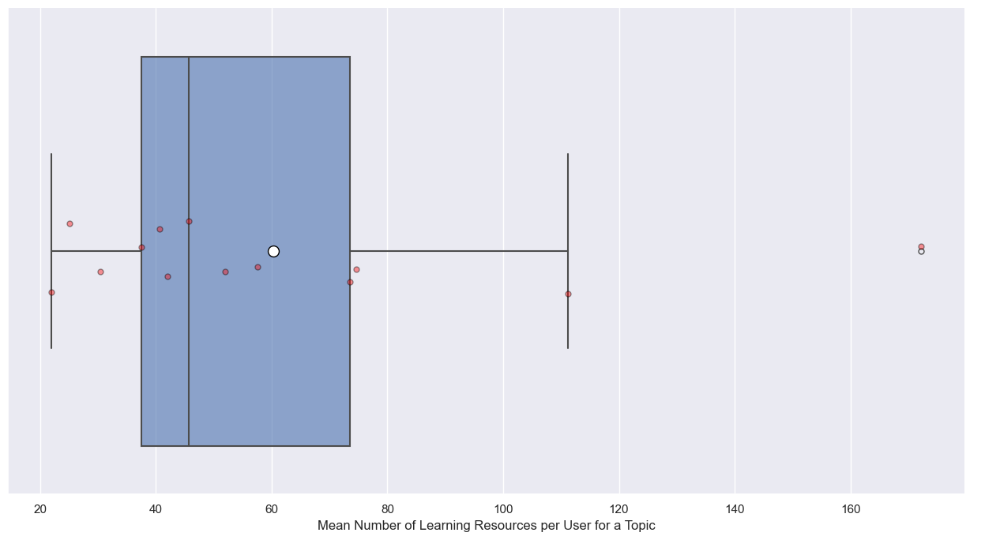

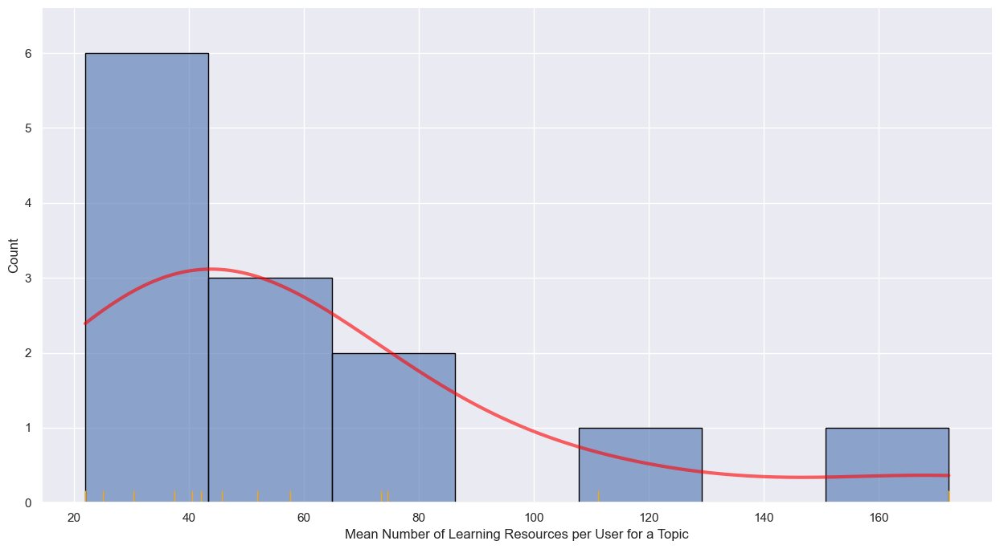



Median:


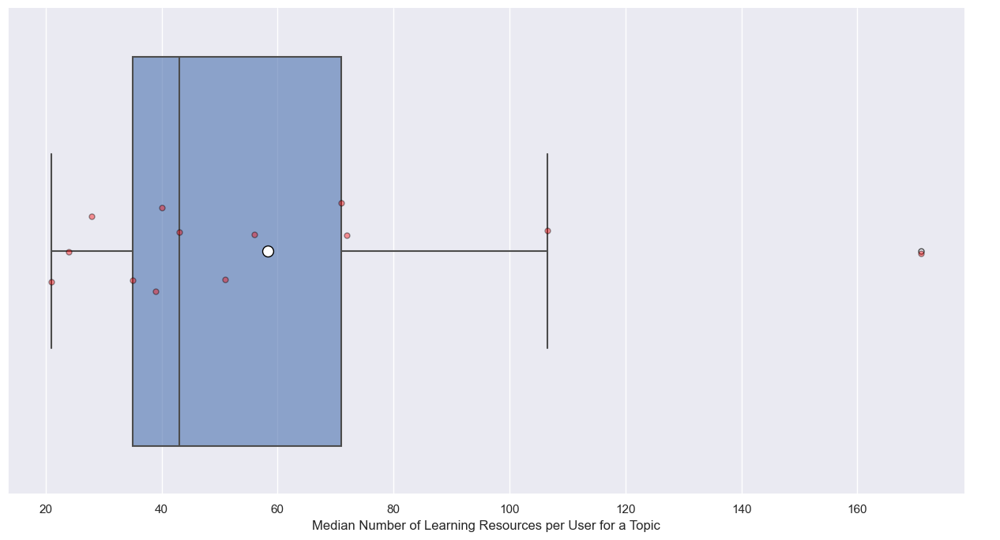

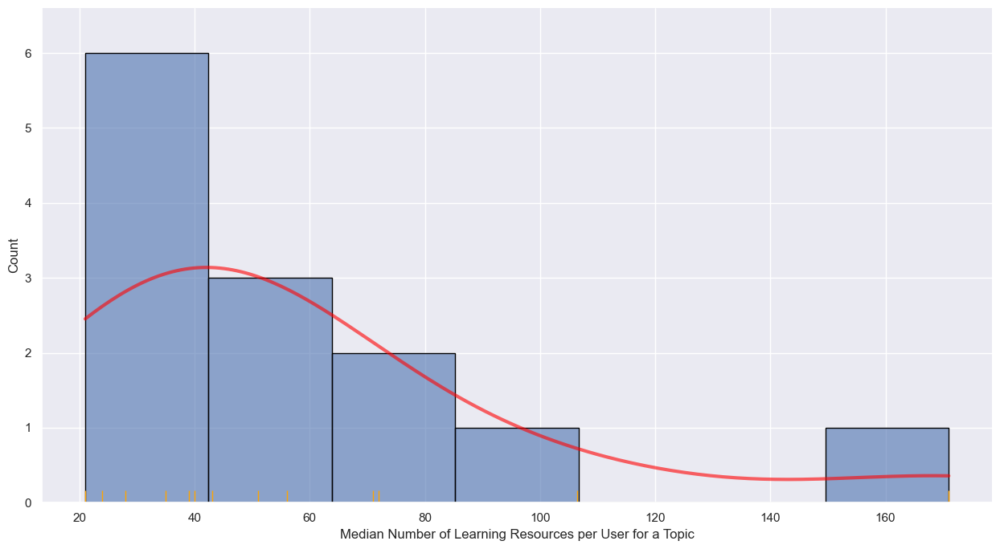

****************************************************************************************************
****************************************************************************************************


----------------------------------------------------------------------------------------------------
Mean/Median Number of Unique Learning Resources per Topic for a User:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Unique Learning Resources per Topic for a User: 34.68410459165359
median of Mean Number of Unique Learning Resources per Topic for a User: 30.0
max of Mean Number of Unique Learning Resources per Topic for a User: 158.0
min of Mean Number of Unique Learning Resources per Topic for a User: 13.0

----------------------------------------------------------------------------------------------------

mean of Median Number of Unique Learning Resources per Topic for a User: 34.645487831143654
median of M

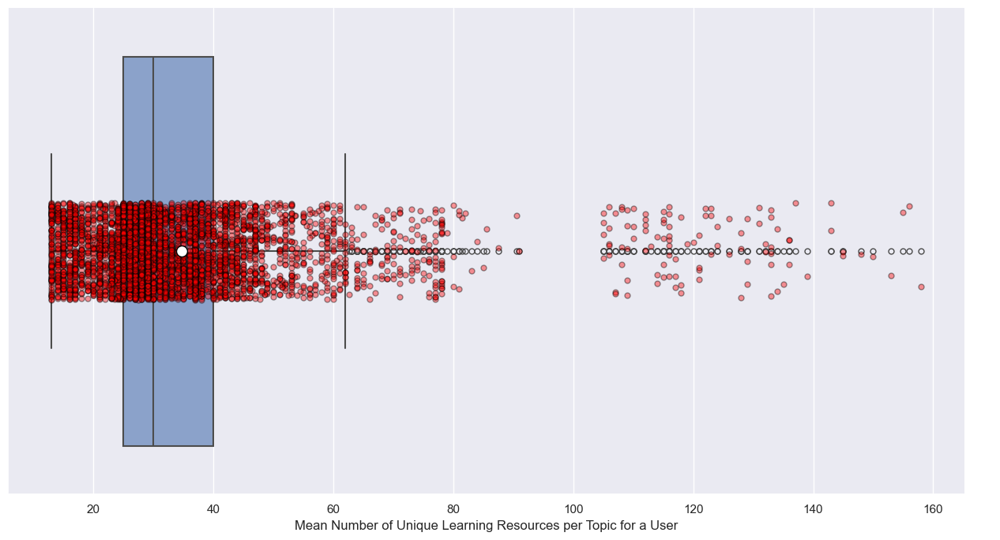

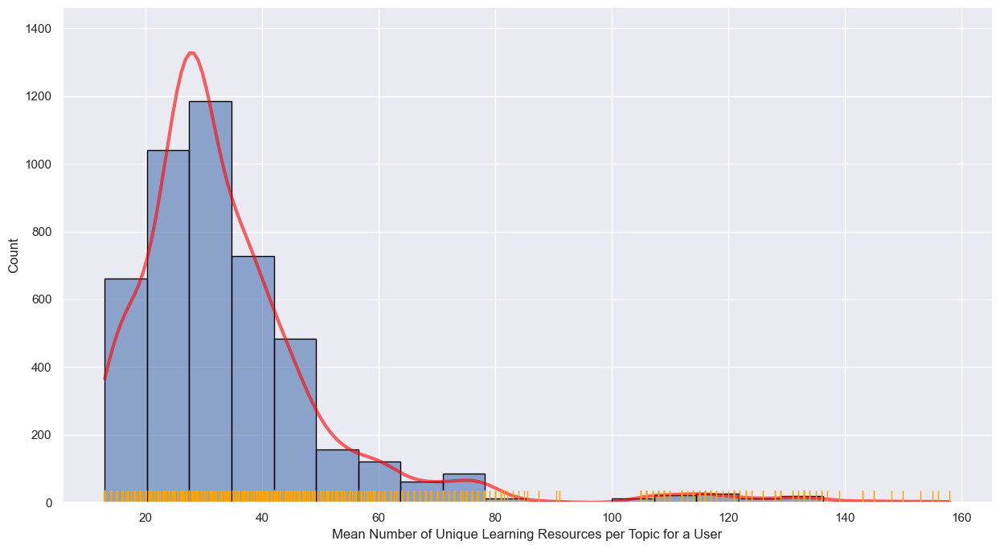



Median:


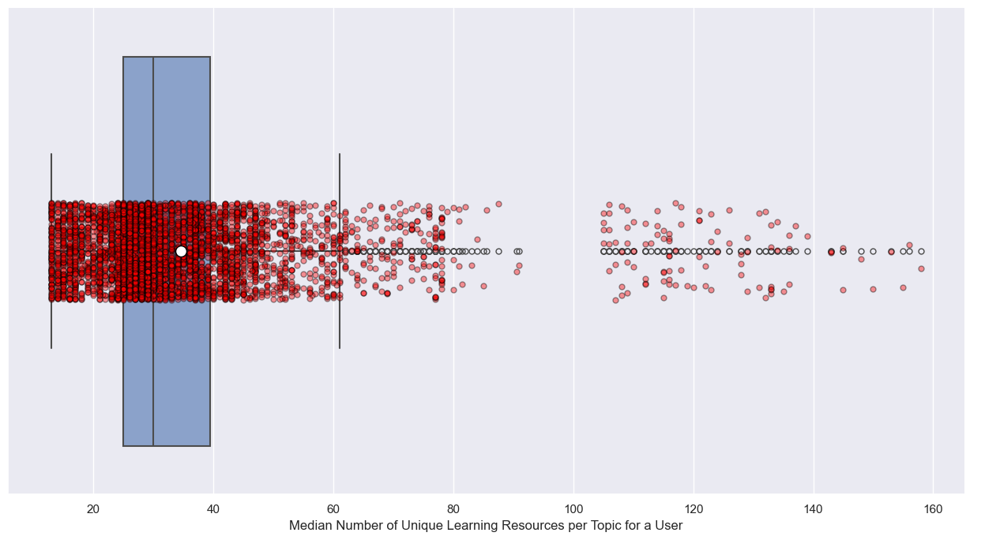

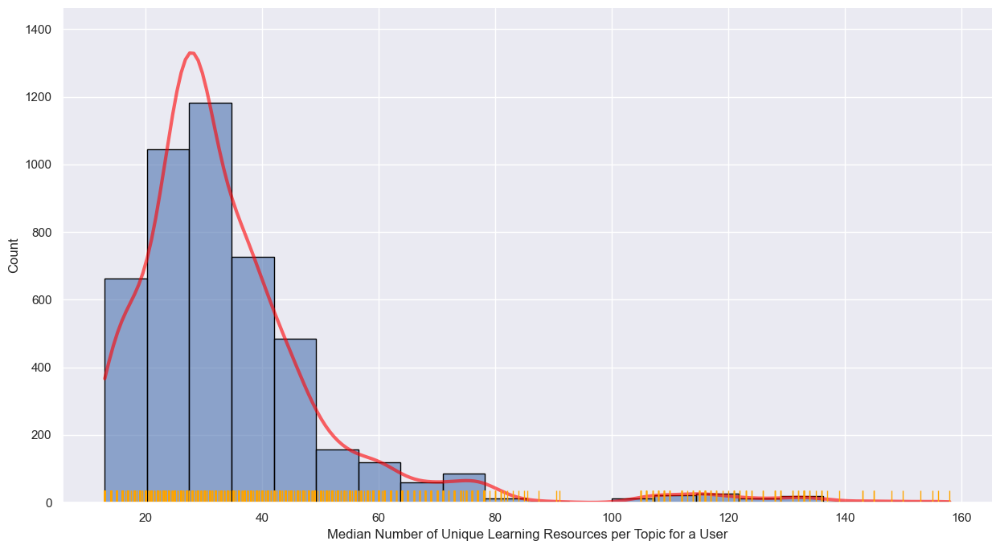

****************************************************************************************************
****************************************************************************************************


----------------------------------------------------------------------------------------------------
Mean/Median Number of Unique Learning Resources per User for a Topic:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Unique Learning Resources per User for a Topic: 42.972816694778594
median of Mean Number of Unique Learning Resources per User for a Topic: 34.15413533834587
max of Mean Number of Unique Learning Resources per User for a Topic: 122.2991452991453
min of Mean Number of Unique Learning Resources per User for a Topic: 14.705426356589147

----------------------------------------------------------------------------------------------------

mean of Median Number of Unique Learning Resources per User for

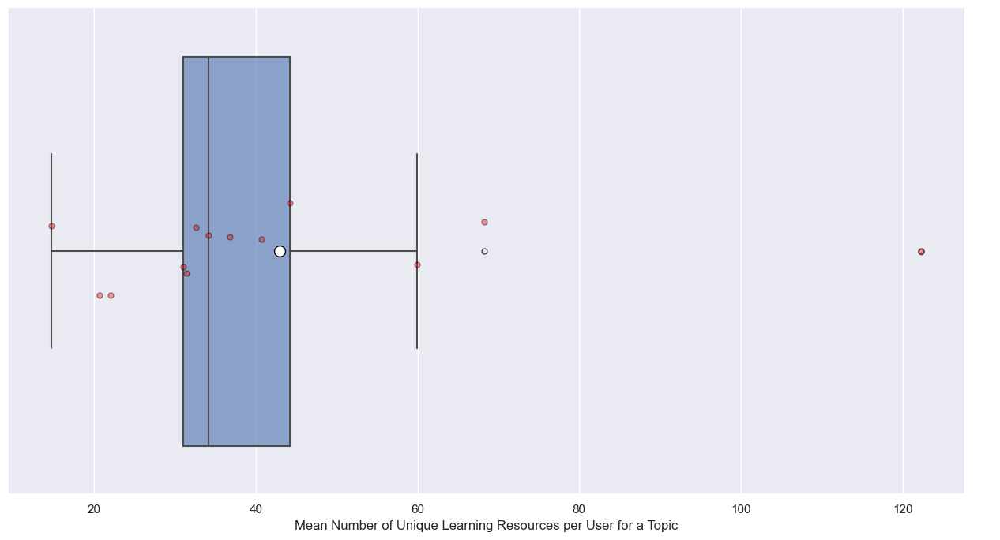

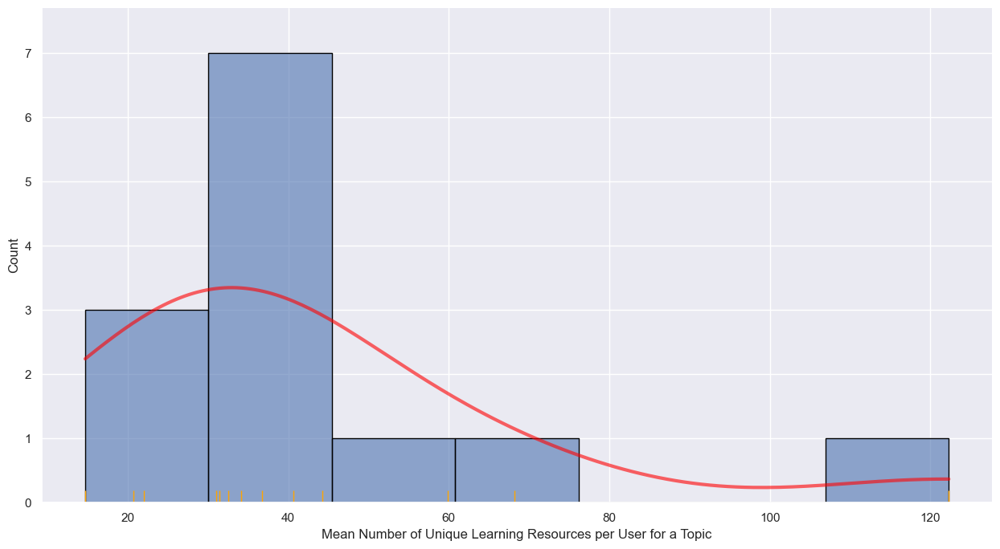



Median:


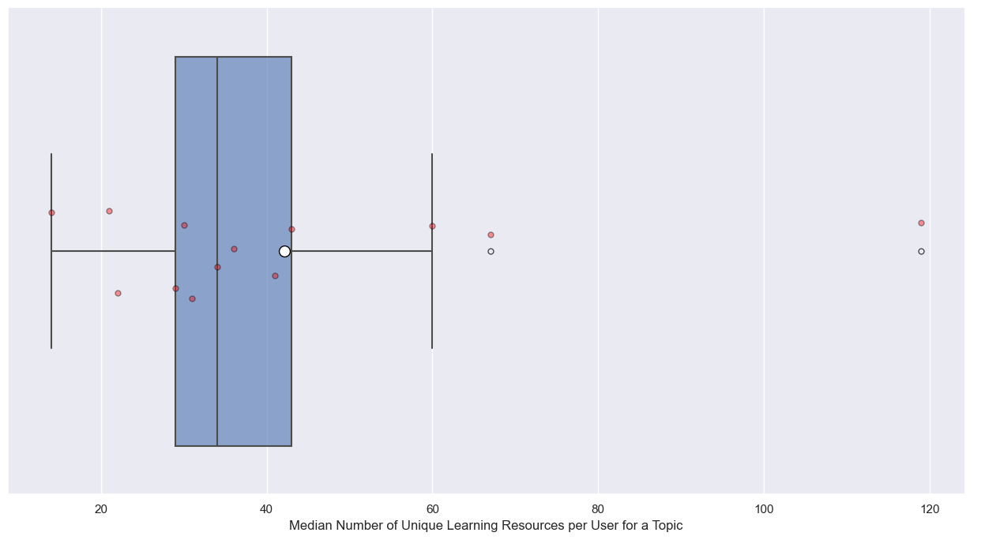

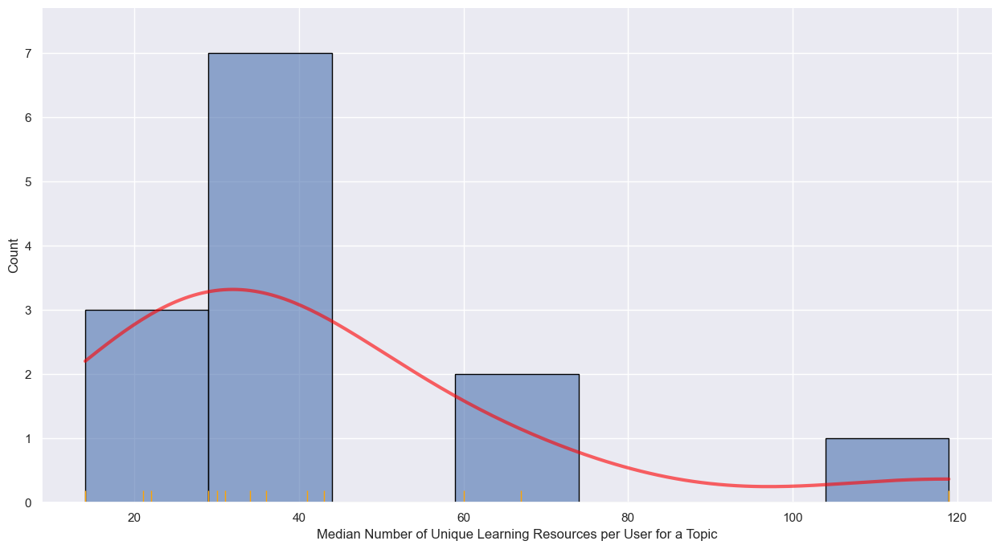

****************************************************************************************************
****************************************************************************************************




In [24]:
print_and_plot_group_user_learning_activity_relationship(interactions,
                                                         GROUP_FIELD,
                                                         False)

## Sequence Statistics

In [25]:
sequence_statistics = SequenceStatistics(interactions,
                                         DATASET_NAME,
                                         GROUP_FIELD,
                                         result_tables)

In [26]:
pickle_write(sequence_statistics,
             SEQUENCE_STATISTICS_PICKLE_PATH_LIST,
             SEQUENCE_STATISTICS_PICKLE_FULL_NAME,
             delete_old_files=DELETE_OLD_PICKLE_FILES)

In [27]:
sequence_statistics.print_seq_count_per_group()


== Sequence Counts per Topic: ==
----------------------------------------------------------------------------------------------------
   Dataset Name  Topic  Sequence Count  Unique Sequence Count
0      kdd_2015      0             715                    706
1      kdd_2015      2             318                    316
2      kdd_2015      7             387                    387
3      kdd_2015     11             561                    531
4      kdd_2015     12             117                    117
5      kdd_2015     13             432                    418
6      kdd_2015     15             391                    391
7      kdd_2015     17             114                    114
8      kdd_2015     22             266                    261
9      kdd_2015     30            1042                   1039
10     kdd_2015     31             369                    369
11     kdd_2015     36             192                    192
12     kdd_2015     37             207                    2

 
****************************************************************************************************
****************************************************************************************************
 
Unique vs Total Number of Sequences per Topic
 


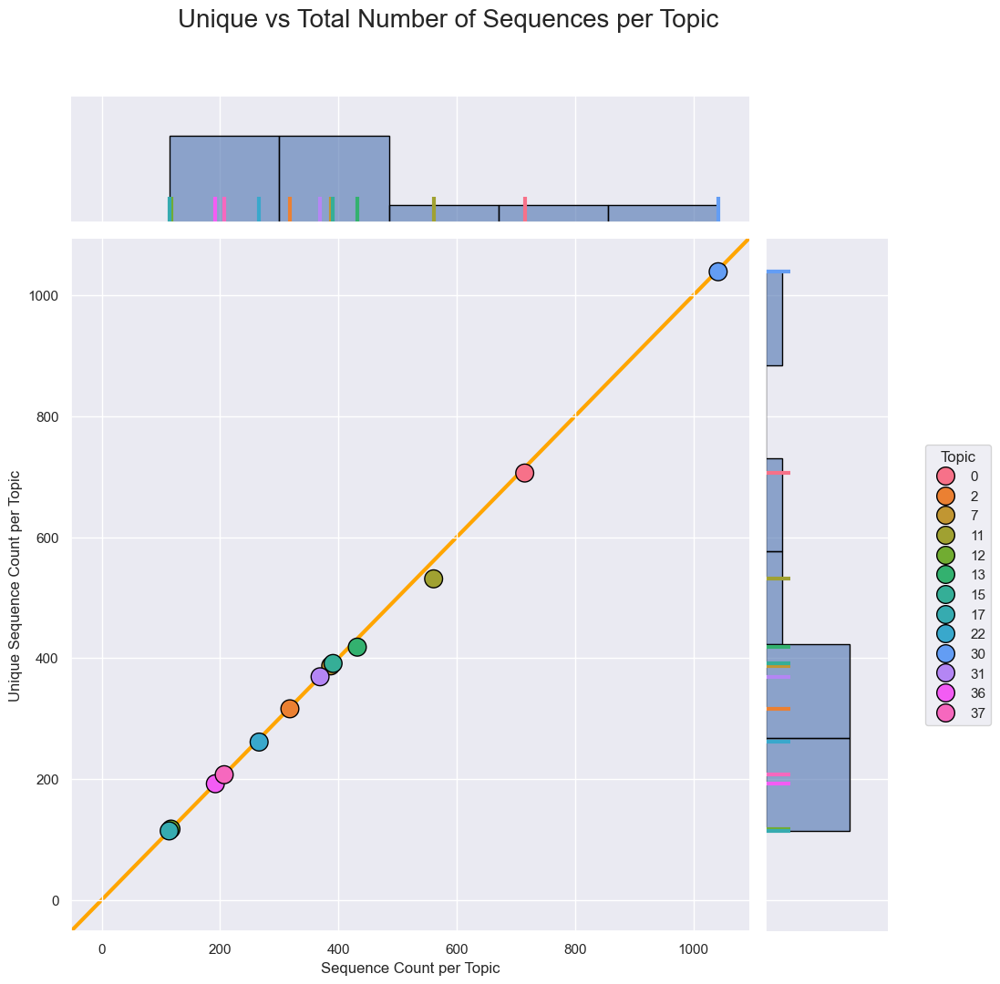

 
****************************************************************************************************
****************************************************************************************************
 
Sequence Frequency %
 
Facet Base:
Unique Sequences within Topic
 


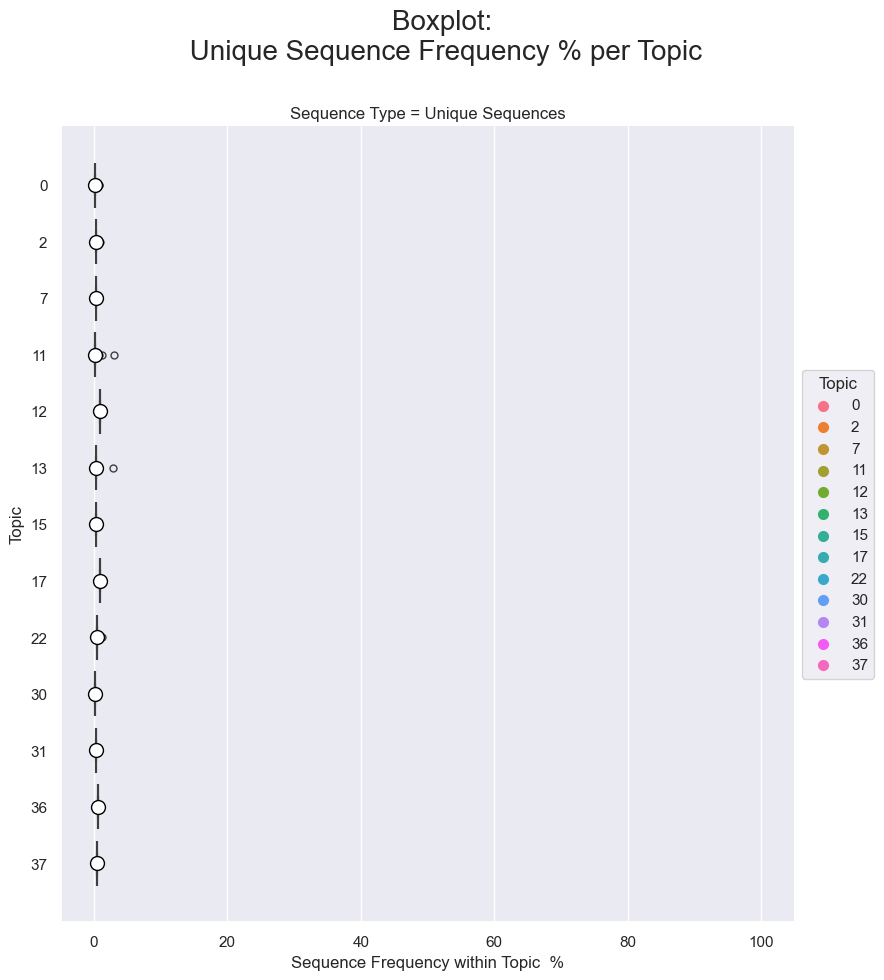

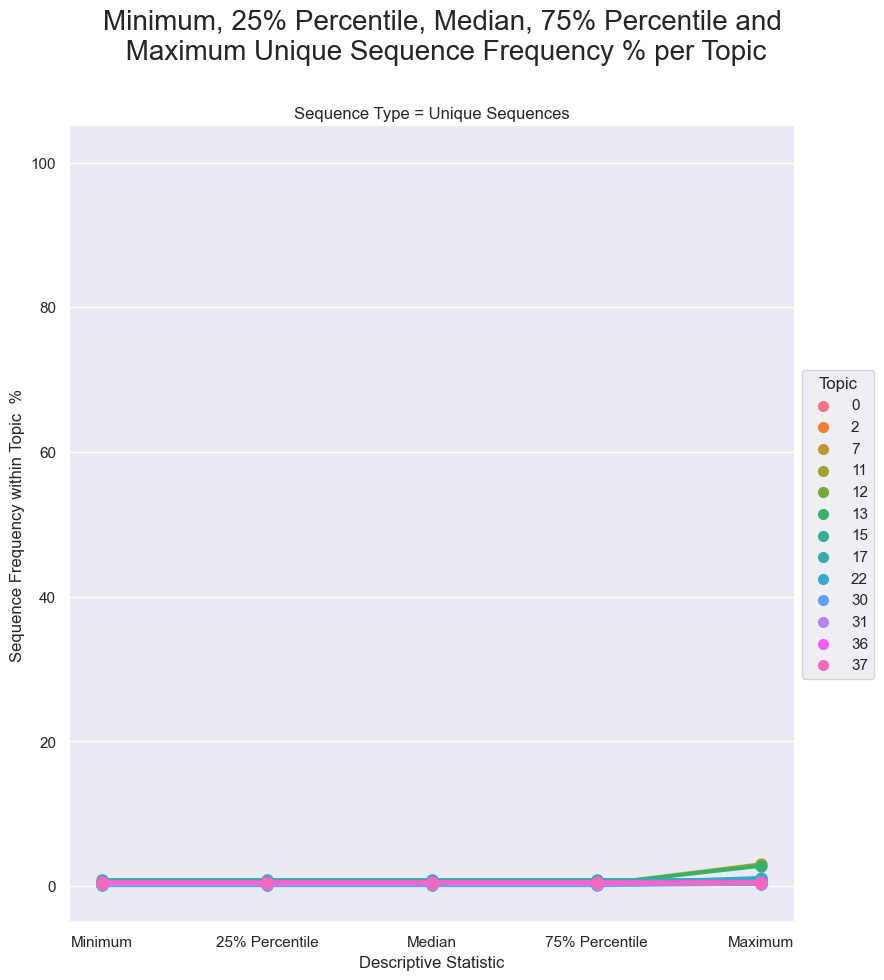

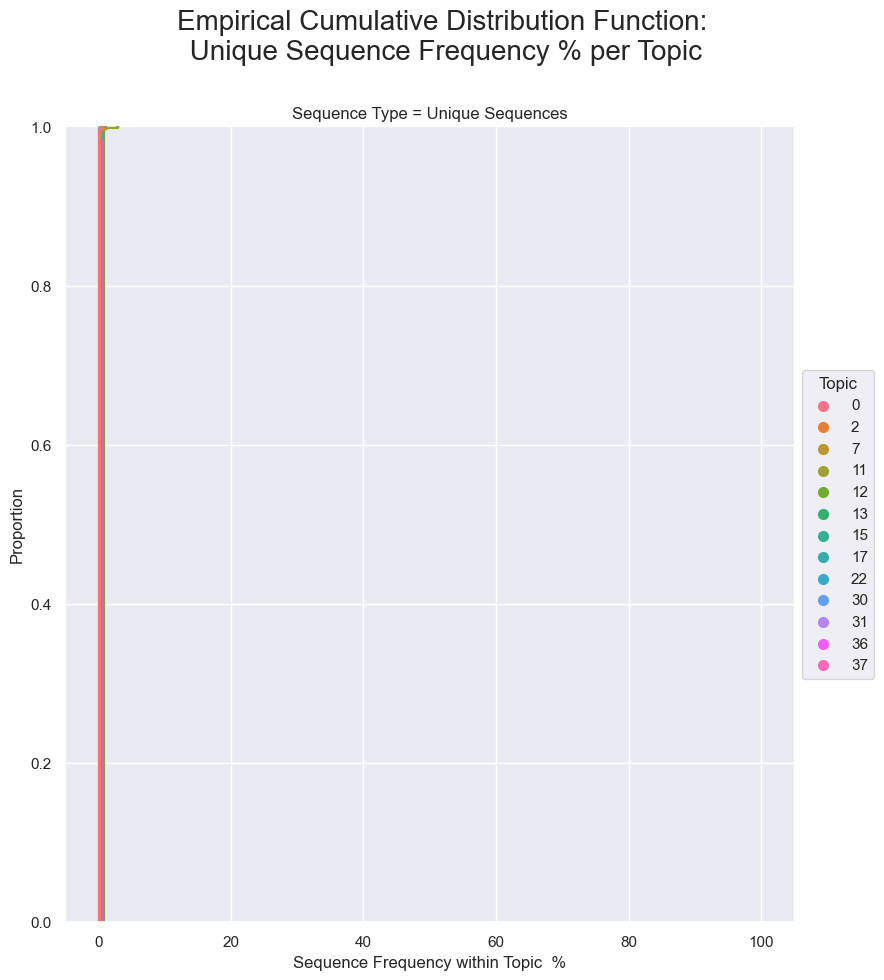

 
****************************************************************************************************
****************************************************************************************************
 
Sequence Length
 
Facet Base:
All Sequences within Topic
VS
Unique Sequences within Topic
 


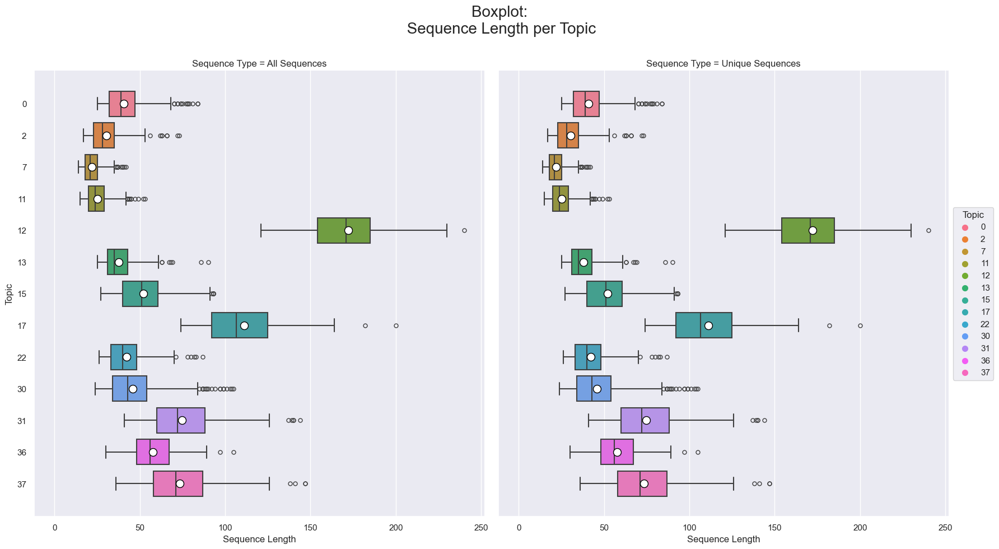

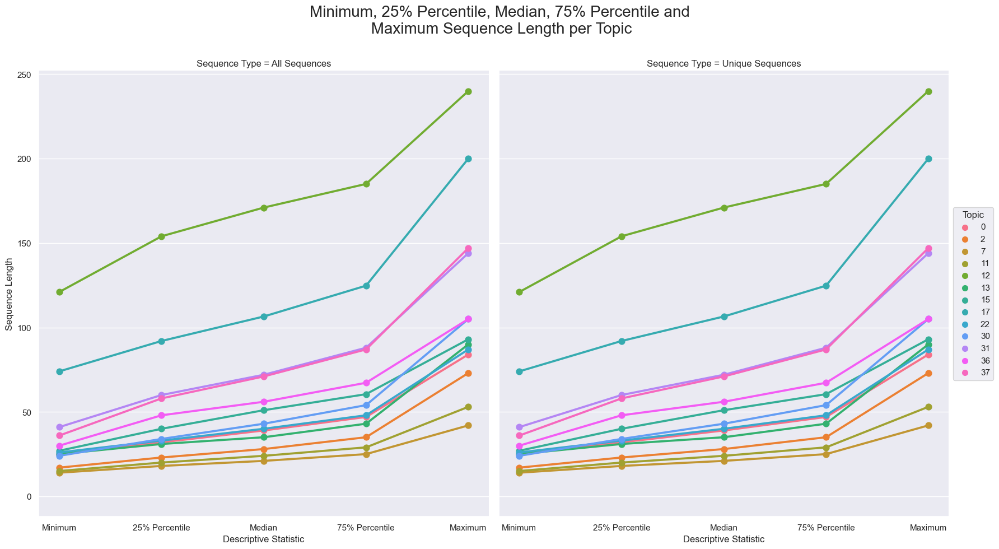

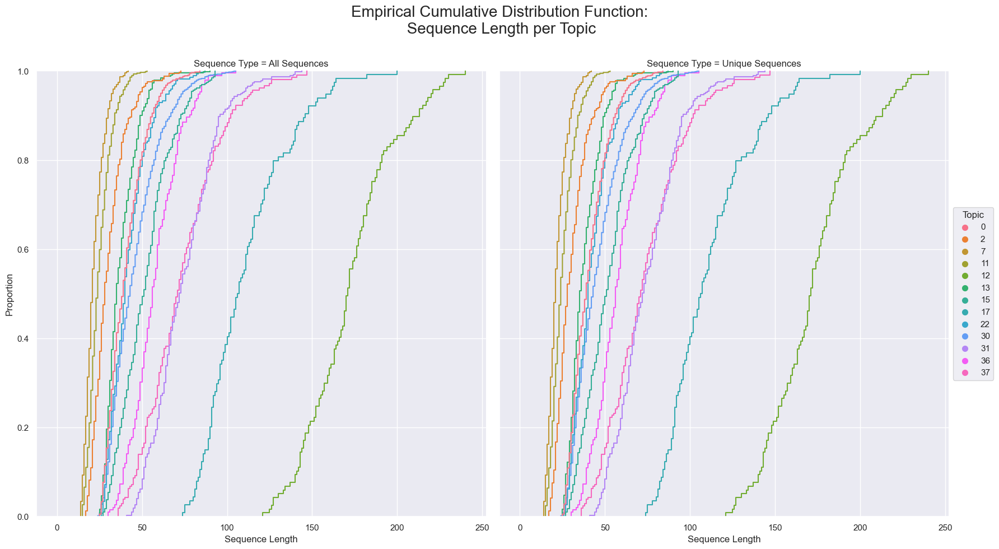

 
****************************************************************************************************
****************************************************************************************************
 
% of Unique Learning Resources per Topic in Sequence
 
Facet Base:
All Sequences within Topic
VS
Unique Sequences within Topic
 


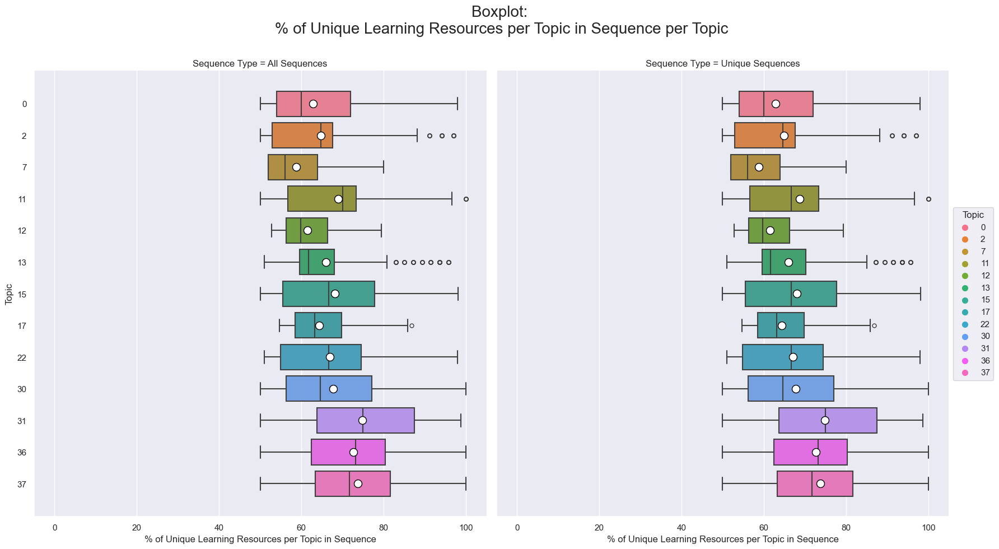

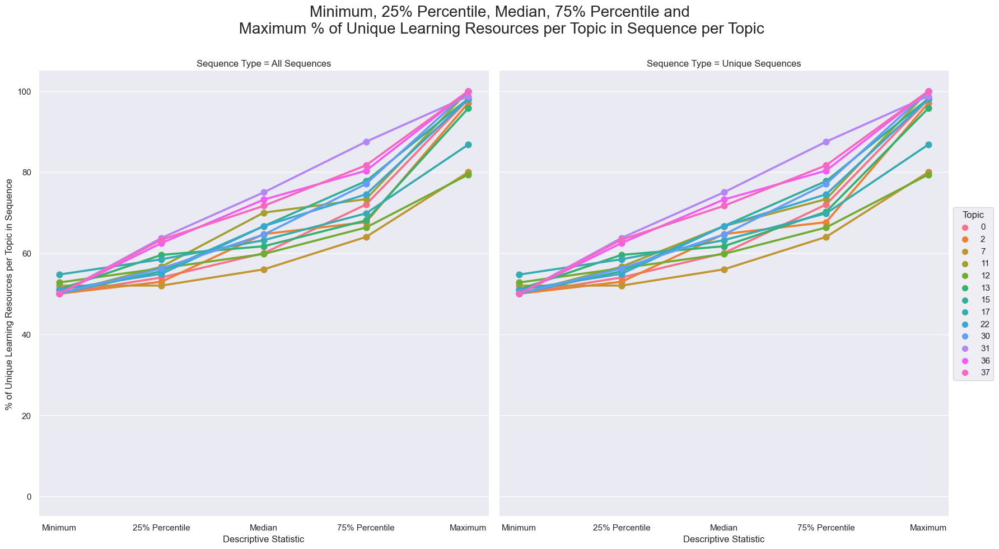

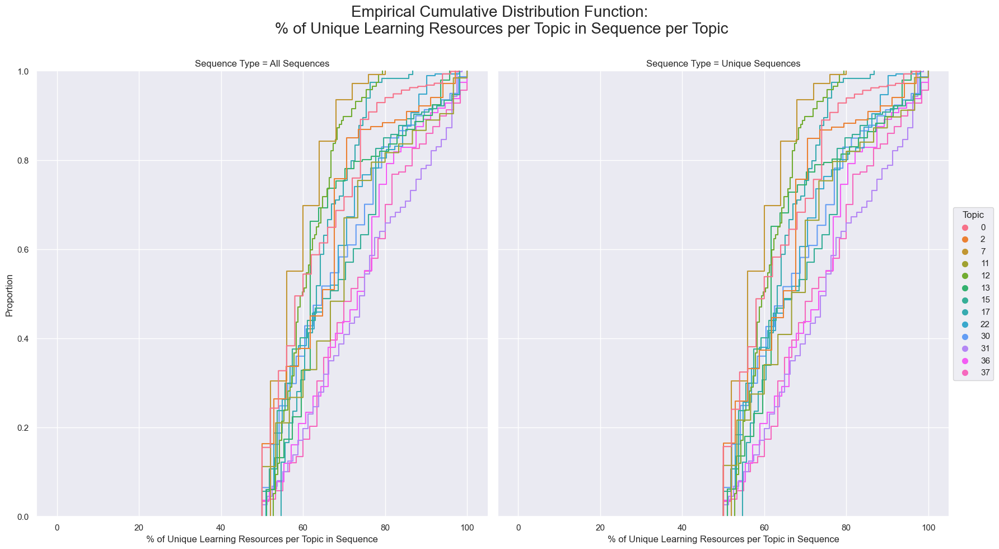

 
****************************************************************************************************
****************************************************************************************************
 
Repeated Learning Resources in Sequence %
 
Facet Base:
All Sequences within Topic
VS
Unique Sequences within Topic
 


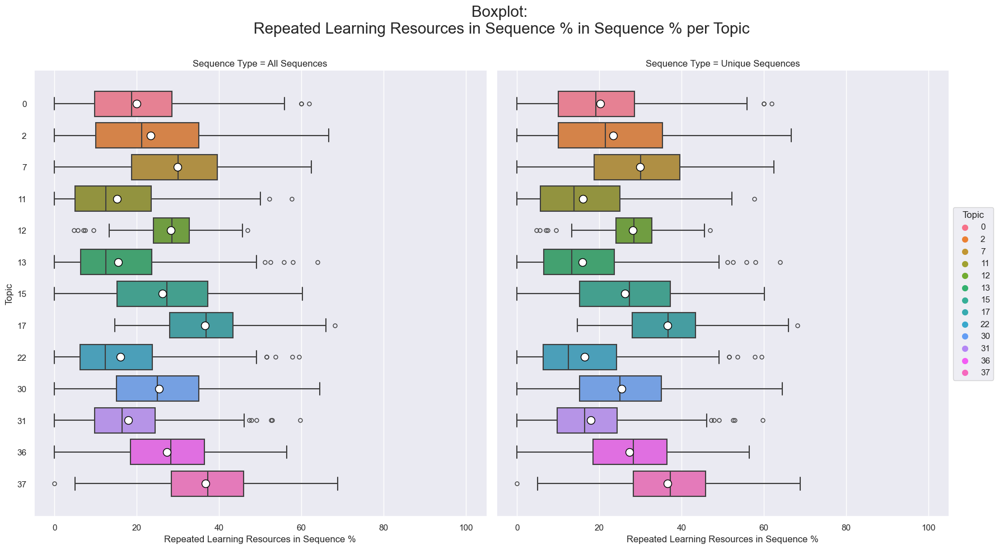

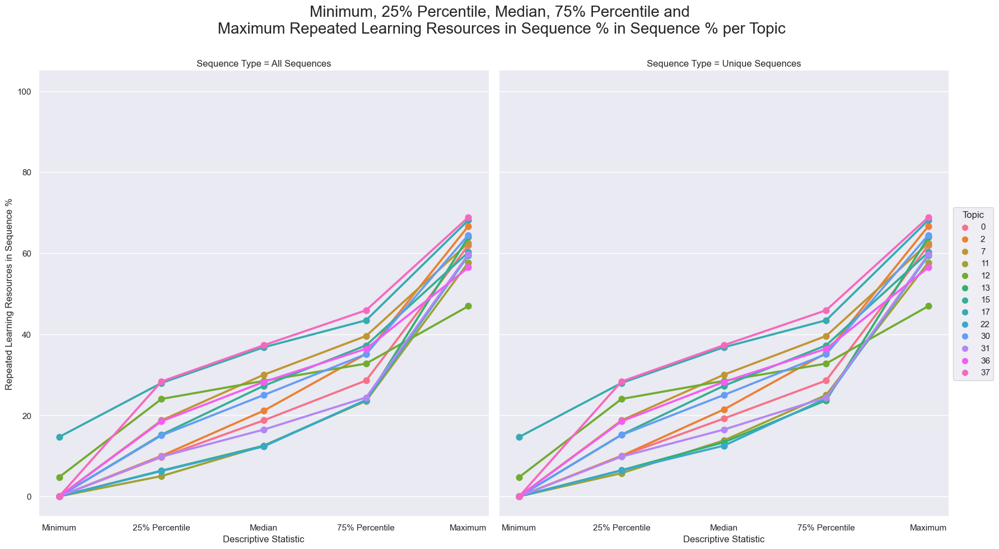

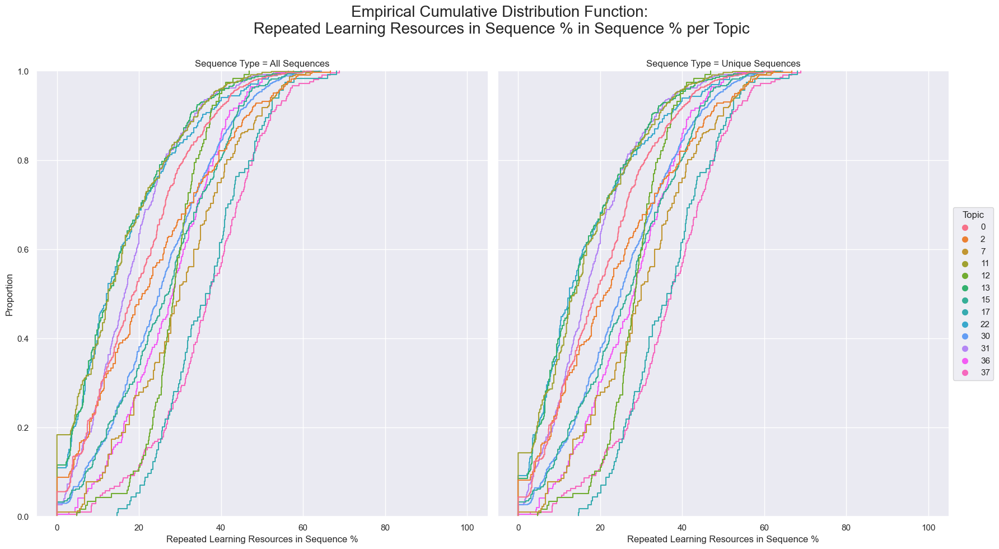

 
****************************************************************************************************
****************************************************************************************************
 
Histogram of Sequence Statistics per Topic:
 
Facet Base:
All Sequences within Topic
VS
Unique Sequences within Topic
 


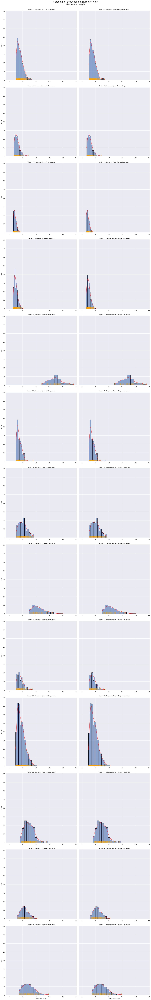

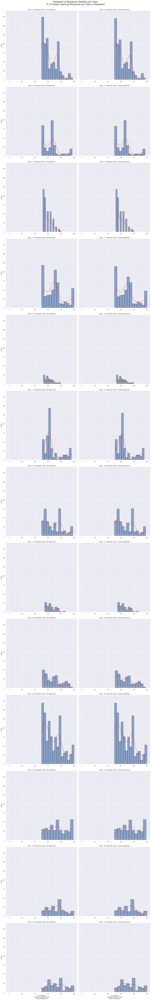

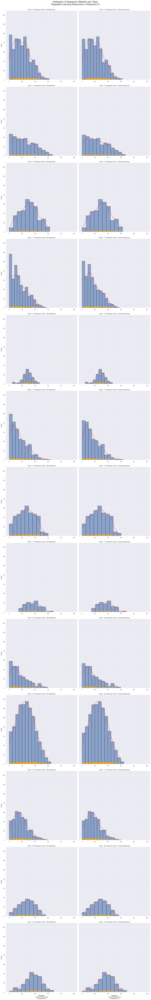

 
****************************************************************************************************
****************************************************************************************************
 
Unique Sequences - Sequence Statistics against Frequency
 
Facet Base:
Unique Sequences within Topic
 


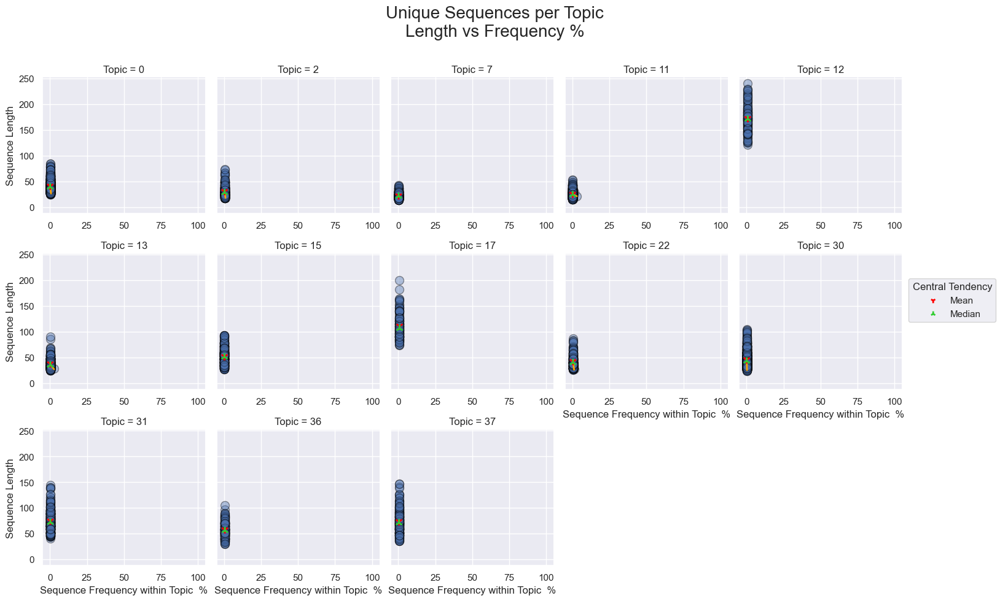

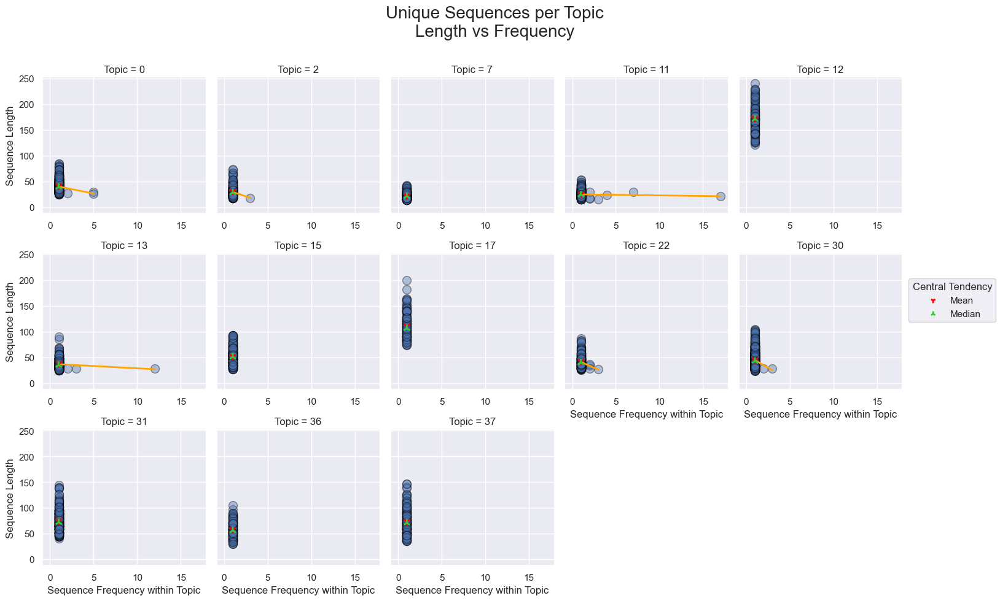

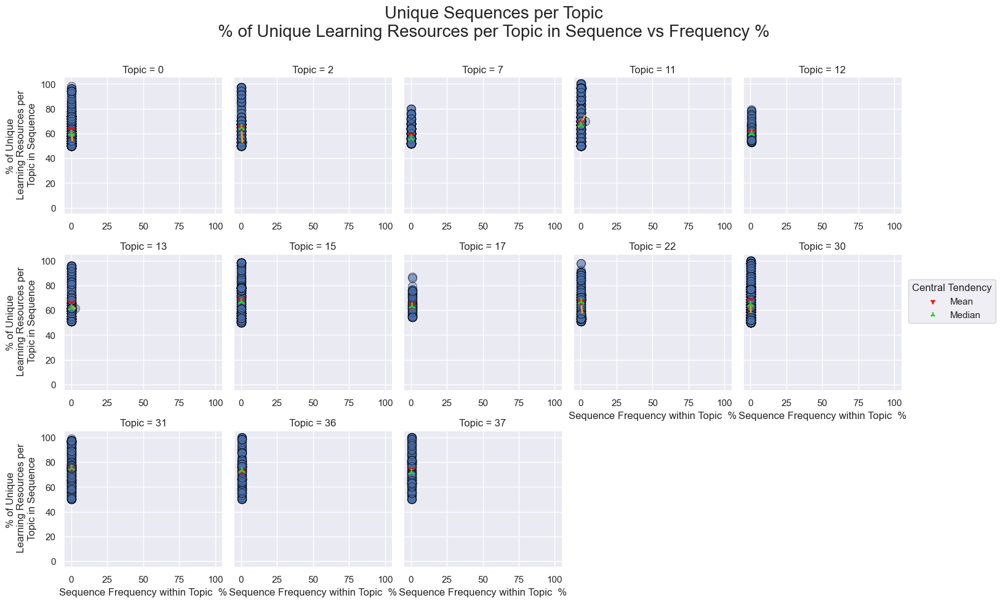

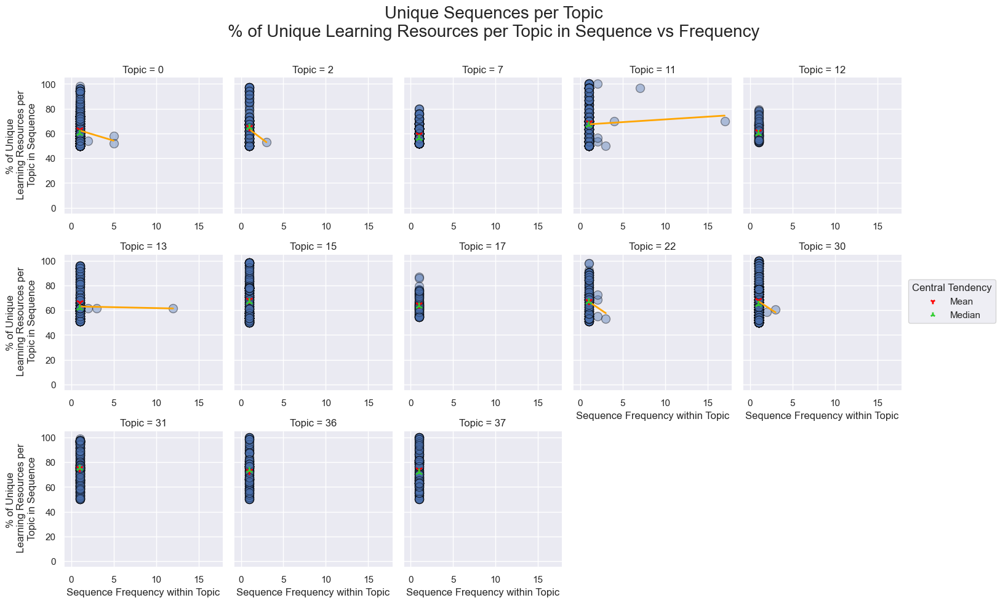

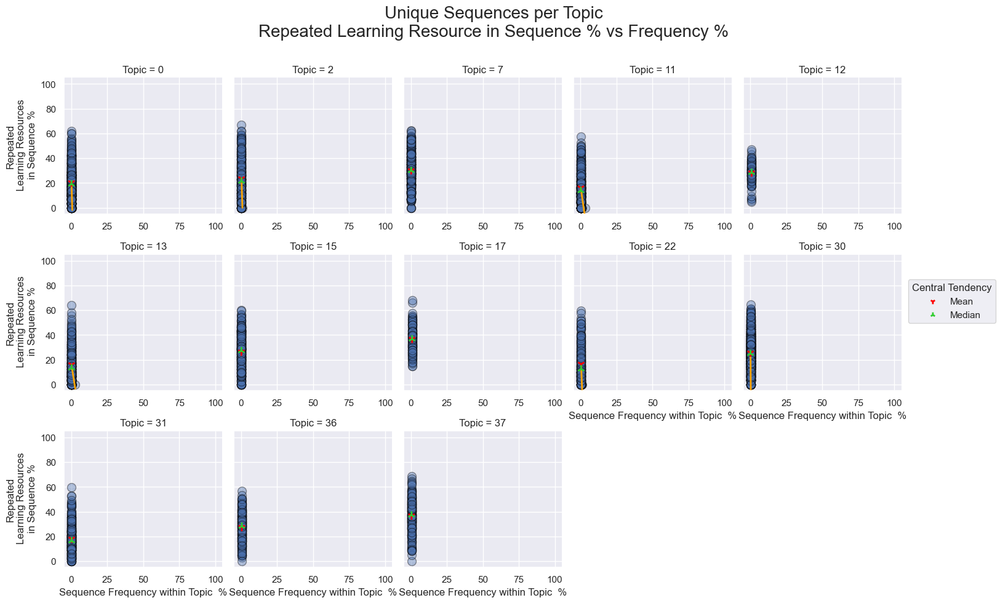

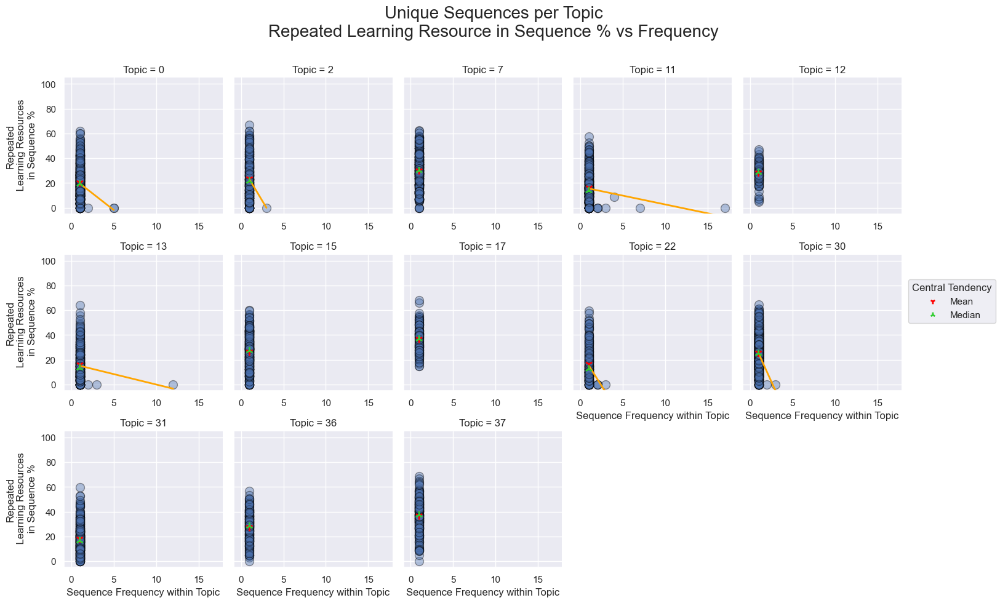

 
****************************************************************************************************
****************************************************************************************************
 
Unique Sequences - Sequence Statistics against each other
 
Facet Base:
Unique Sequences within Topic
 


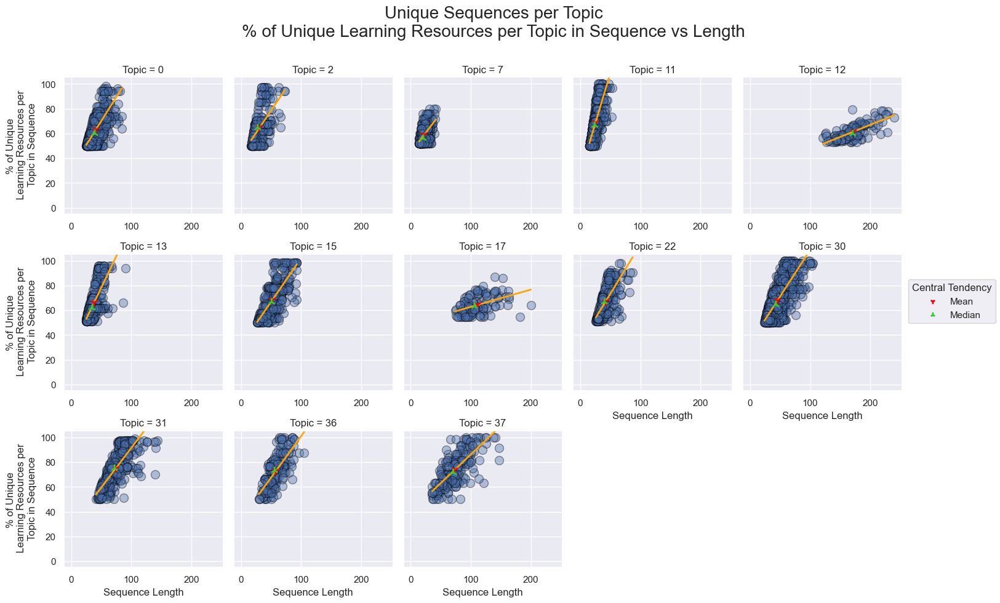

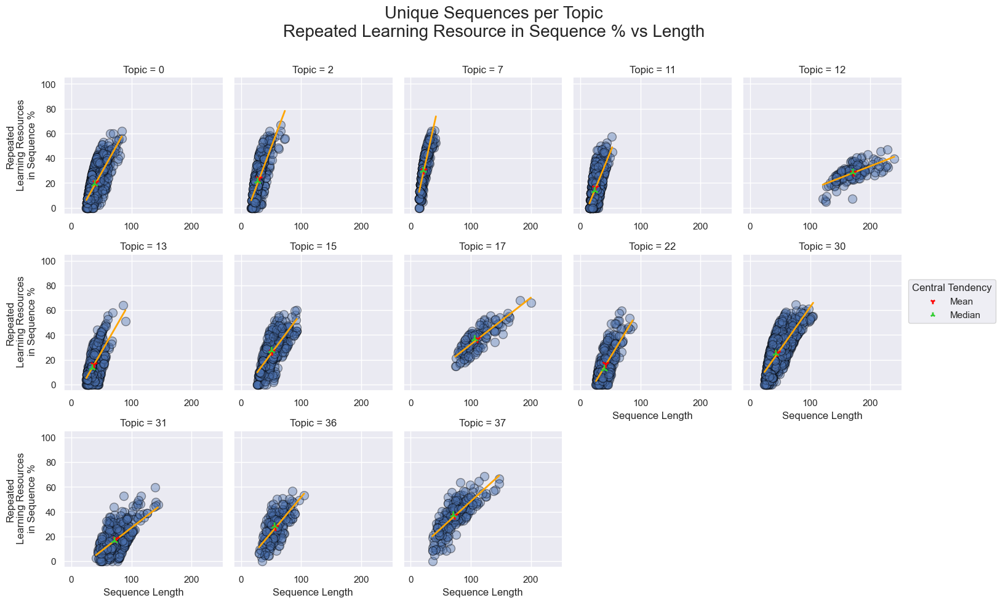

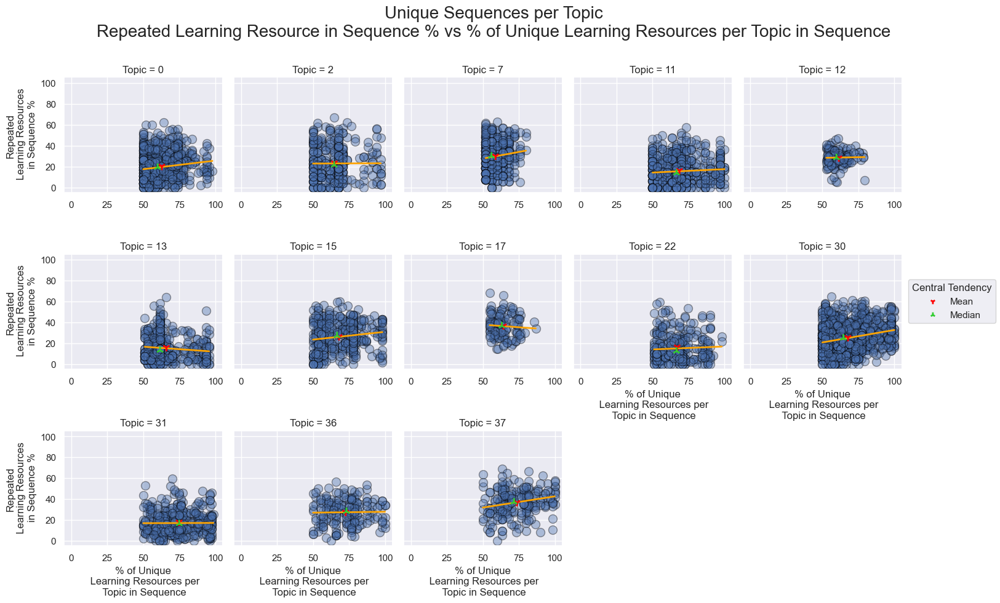

In [28]:
sequence_statistics.plot_sequence_stats_per_group()

## Sequence Distance

In [29]:
calculate_sequence_distances(DATASET_NAME,
                             interactions,
                             GROUP_FIELD,
                             SEQUENCE_DISTANCE_IGNORE_GROUPS)

----------------------------------------------------------------------------------------------------
Topic-Field Available:
Calculate Sequence Distances for each Topic
----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
Total number of Topic: 13
----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
Final number of Topics: 13
Final number of Users: 4643
Final number of Rows: 243169
----------------------------------------------------------------------------------------------------


100%|██████████| 13/13 [00:00<00:00, 17.26it/s]


----------------------------------------------------------------------------------------------------
Duration in seconds: 10.316871881484985
----------------------------------------------------------------------------------------------------


In [30]:
sequence_distance_analytics = SequenceDistanceAnalytics(DATASET_NAME,
                                                        interactions,
                                                        sequence_statistics.unique_learning_activity_sequence_stats_per_group,
                                                        sequence_statistics.learning_activity_sequence_stats_per_group)

In [31]:
pickle_write(sequence_distance_analytics,
             SEQUENCE_DISTANCE_ANALYTICS_PICKLE_PATH_LIST,
             SEQUENCE_DISTANCE_ANALYTICS_PICKLE_FULL_NAME,
             delete_old_files=DELETE_OLD_PICKLE_FILES)

 
****************************************************************************************************
****************************************************************************************************
 
Sequence Distance Statistics Plots per Topic:
 
Sequence Distance Type:
Mean Sequence Distance over all Sequences
 
Sequence Distance is Normalized:
False
 
Sequence Distance Calculation Base:
all_sequences
 
Sequence Distance Averaging Method:
mean
 
Facet Base:
All Sequences within Topic
VS
Unique Sequences within Topic
 


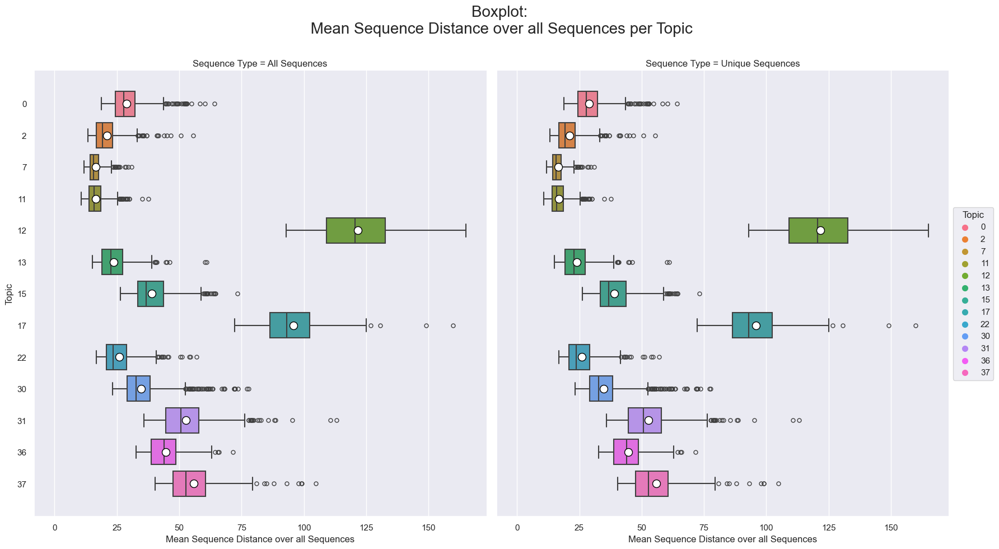

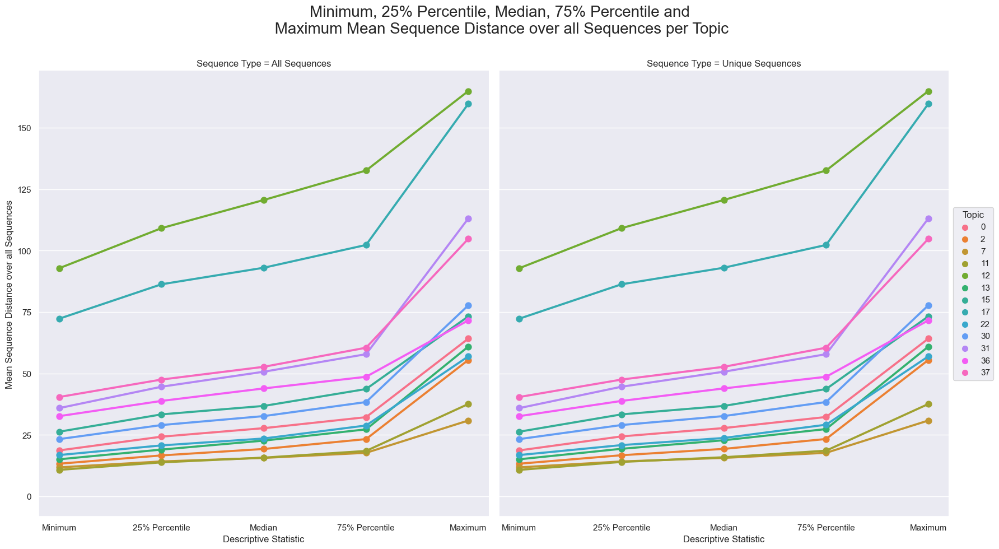

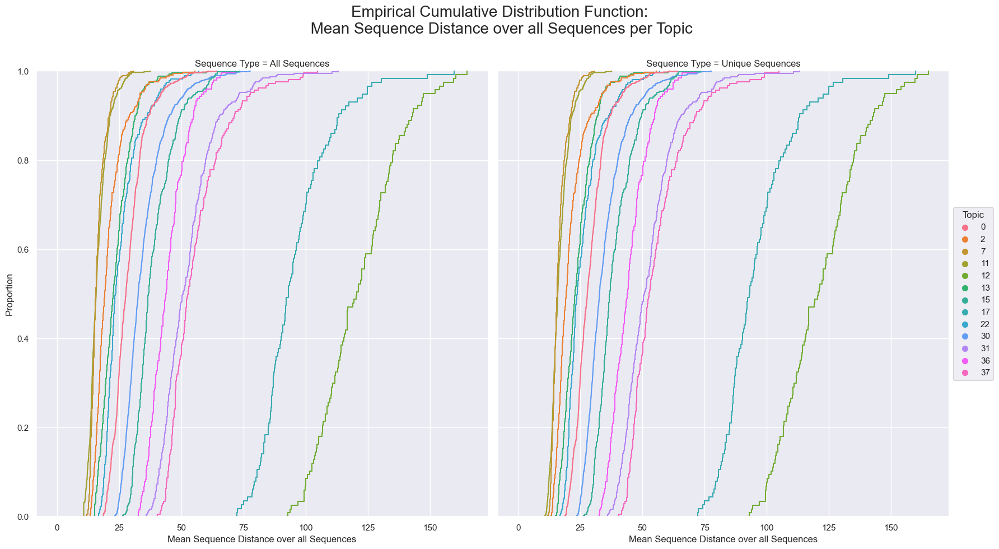

 
****************************************************************************************************
****************************************************************************************************
 
Histogram of Sequence Distance per Topic:
 
Sequence Distance Type:
Mean Sequence Distance over all Sequences
 
Sequence Distance is Normalized:
False
 
Sequence Distance Calculation Base:
all_sequences
 
Sequence Distance Averaging Method:
mean
 
Facet Base:
All Sequences within Topic
VS
Unique Sequences within Topic
 


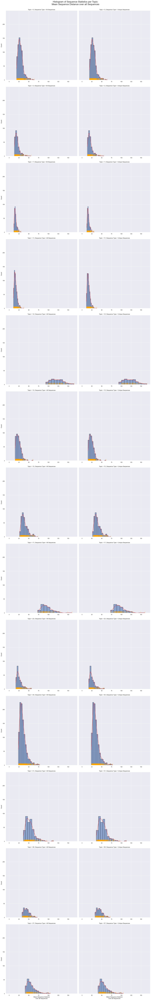

 
****************************************************************************************************
****************************************************************************************************
 
Unique Sequences - Sequence Distance against Frequency
 
Sequence Distance Type:
Mean Sequence Distance over all Sequences
 
Sequence Distance is Normalized:
False
 
Sequence Distance Calculation Base:
all_sequences
 
Sequence Distance Averaging Method:
mean
 
Facet Base:
Unique Sequences within Topic
 


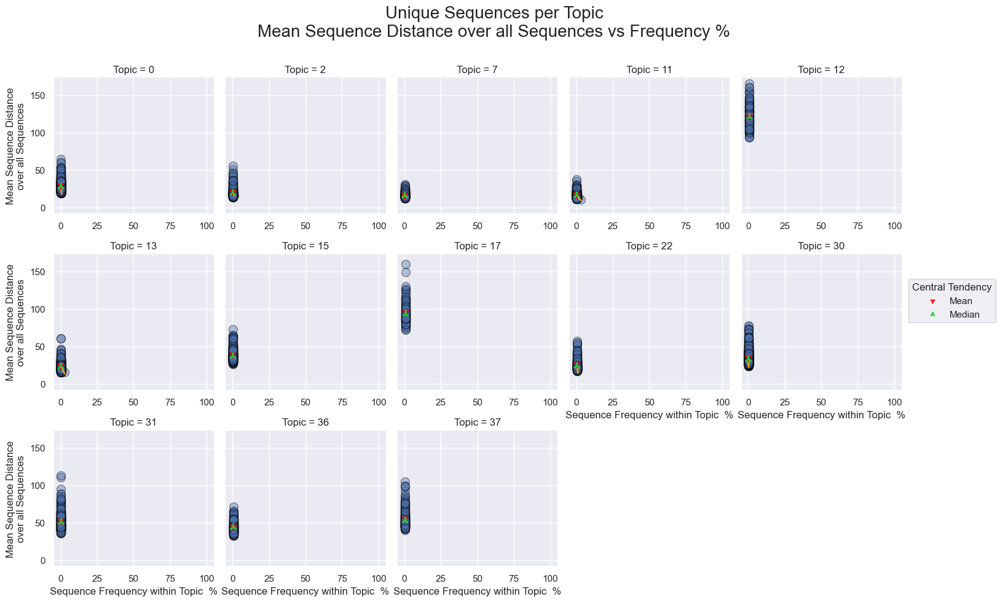

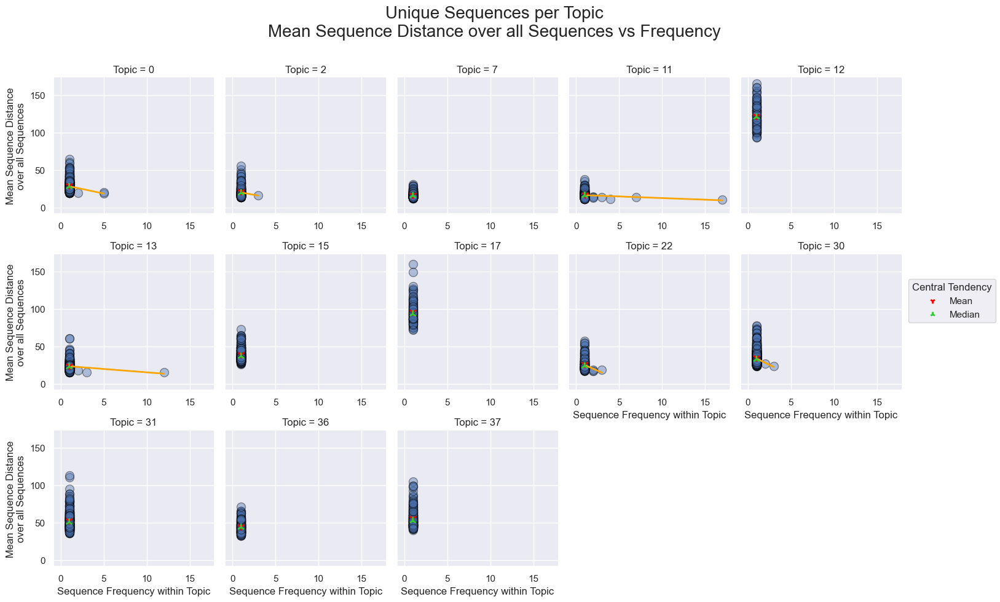

 
****************************************************************************************************
****************************************************************************************************
 
Unique Sequences - Sequence Distance against Sequence Statistic
 
Sequence Distance Type:
Mean Sequence Distance over all Sequences
 
Sequence Distance is Normalized:
False
 
Sequence Distance Calculation Base:
all_sequences
 
Sequence Distance Averaging Method:
mean
 
Facet Base:
Unique Sequences within Topic
 


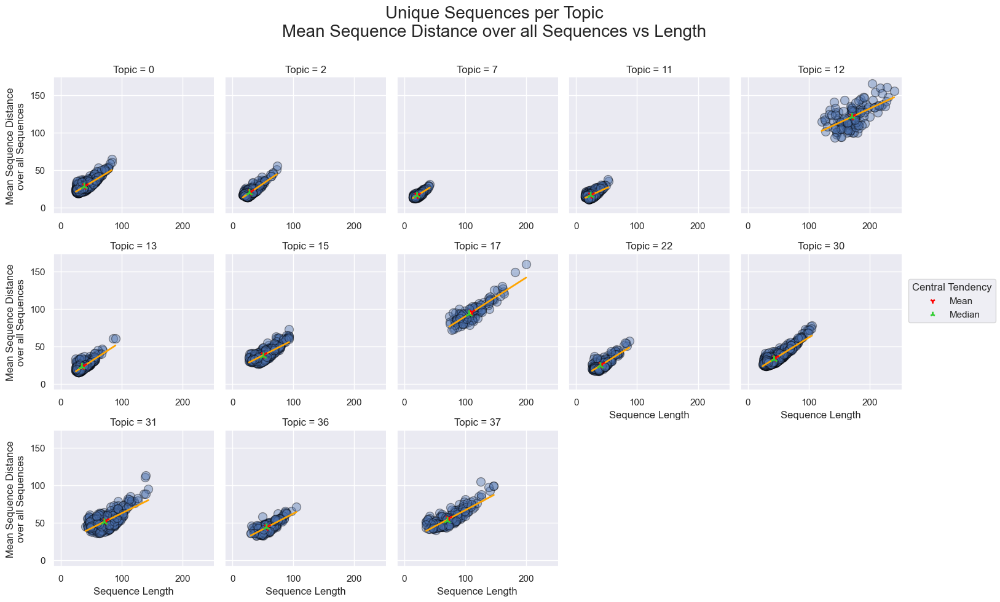

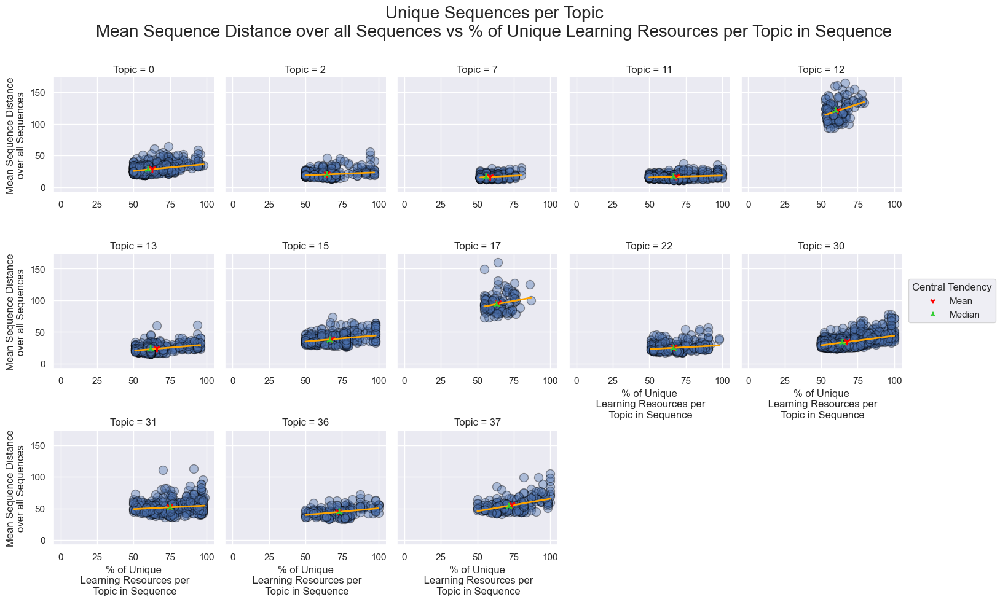

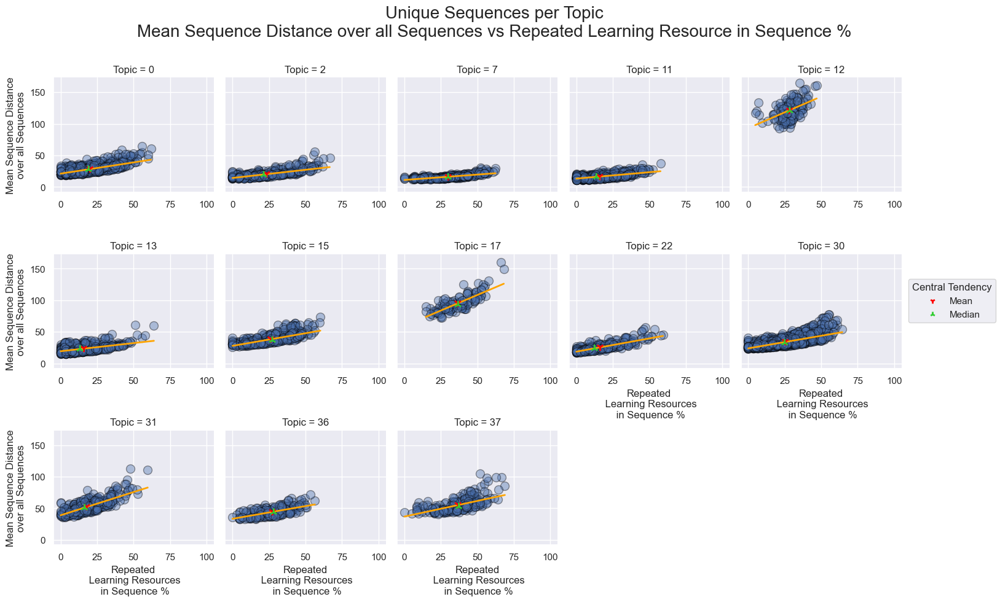

 
****************************************************************************************************
****************************************************************************************************
 
Sequence Distance Statistics Plots per Topic:
 
Sequence Distance Type:
Mean Normalized Sequence Distance over all Sequences
 
Sequence Distance is Normalized:
True
 
Sequence Distance Calculation Base:
all_sequences
 
Sequence Distance Averaging Method:
mean
 
Facet Base:
All Sequences within Topic
VS
Unique Sequences within Topic
 


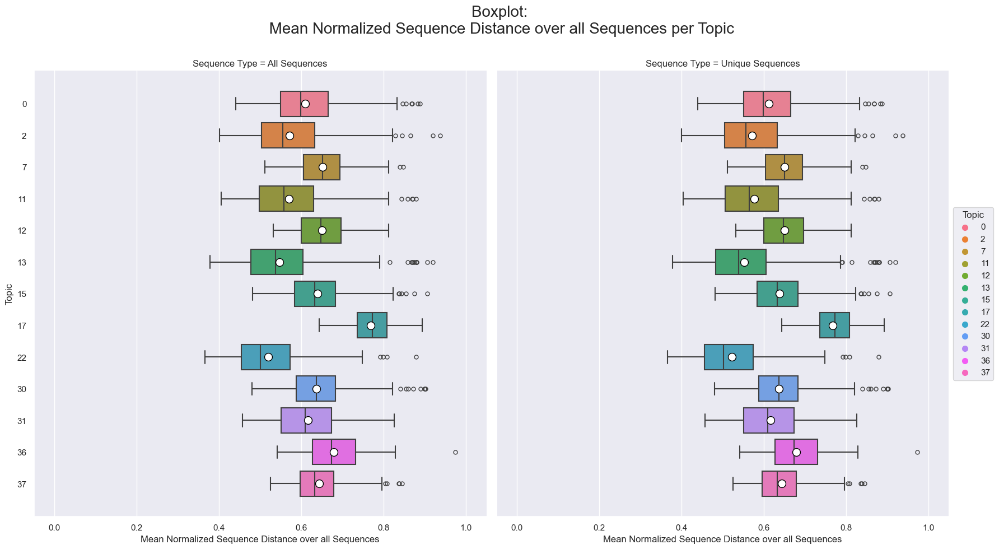

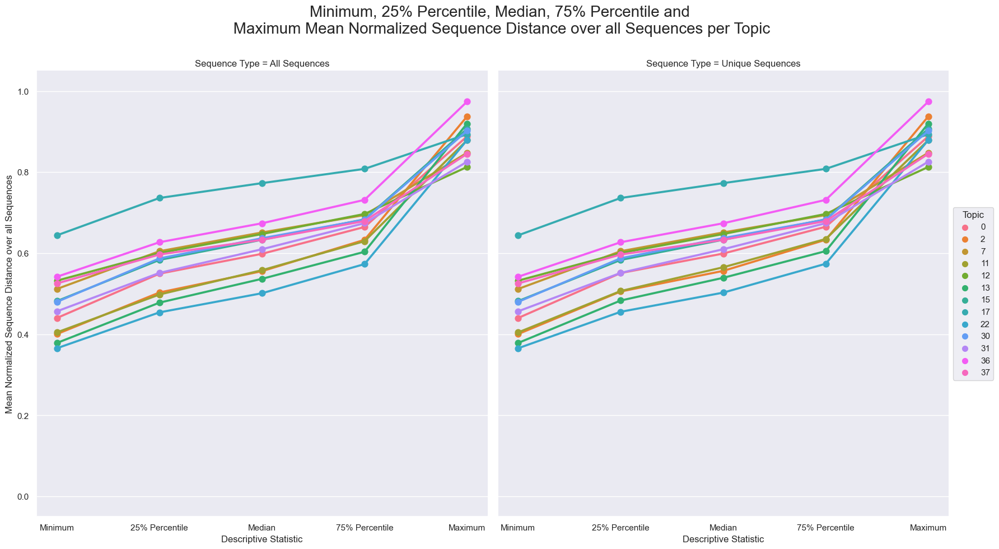

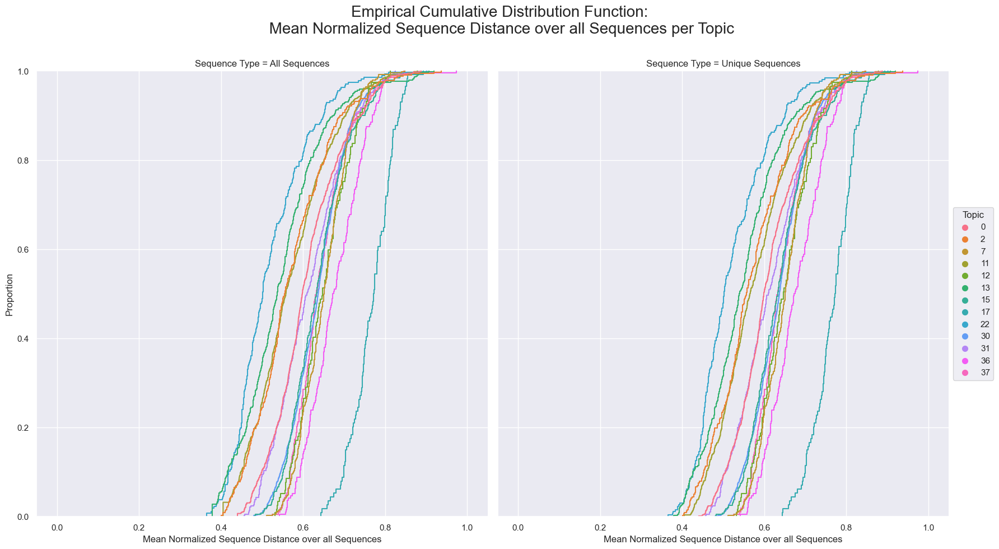

 
****************************************************************************************************
****************************************************************************************************
 
Histogram of Sequence Distance per Topic:
 
Sequence Distance Type:
Mean Normalized Sequence Distance over all Sequences
 
Sequence Distance is Normalized:
True
 
Sequence Distance Calculation Base:
all_sequences
 
Sequence Distance Averaging Method:
mean
 
Facet Base:
All Sequences within Topic
VS
Unique Sequences within Topic
 


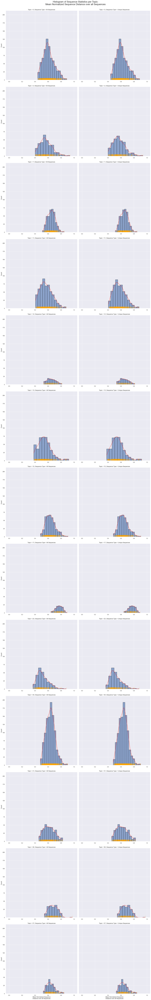

 
****************************************************************************************************
****************************************************************************************************
 
Unique Sequences - Sequence Distance against Frequency
 
Sequence Distance Type:
Mean Normalized Sequence Distance over all Sequences
 
Sequence Distance is Normalized:
True
 
Sequence Distance Calculation Base:
all_sequences
 
Sequence Distance Averaging Method:
mean
 
Facet Base:
Unique Sequences within Topic
 


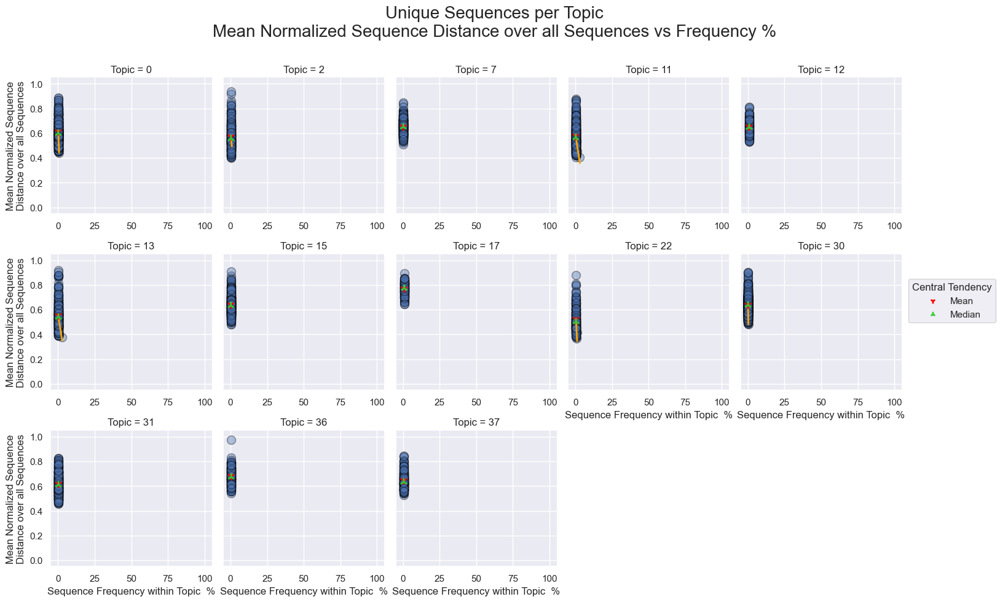

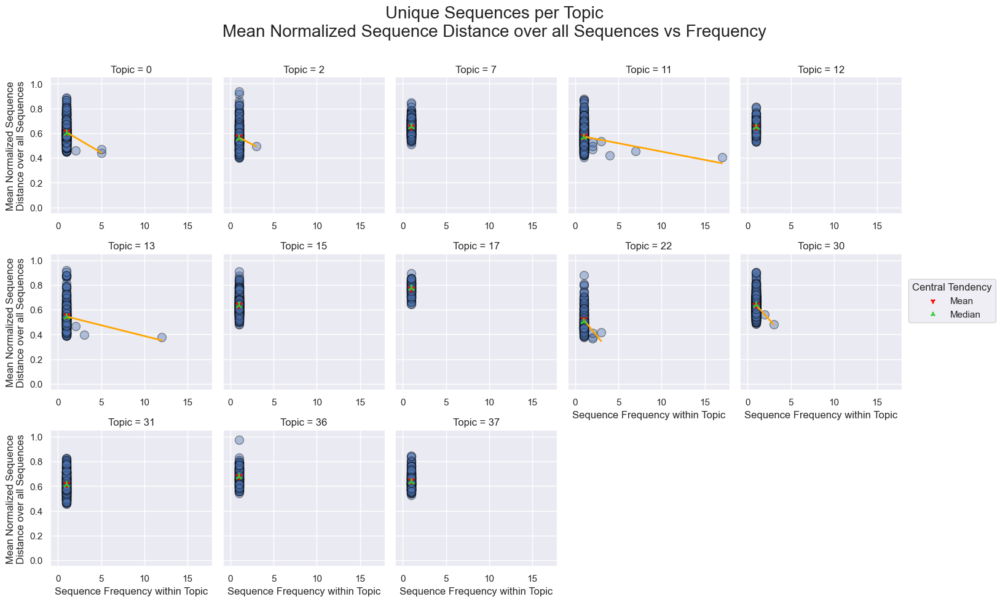

 
****************************************************************************************************
****************************************************************************************************
 
Unique Sequences - Sequence Distance against Sequence Statistic
 
Sequence Distance Type:
Mean Normalized Sequence Distance over all Sequences
 
Sequence Distance is Normalized:
True
 
Sequence Distance Calculation Base:
all_sequences
 
Sequence Distance Averaging Method:
mean
 
Facet Base:
Unique Sequences within Topic
 


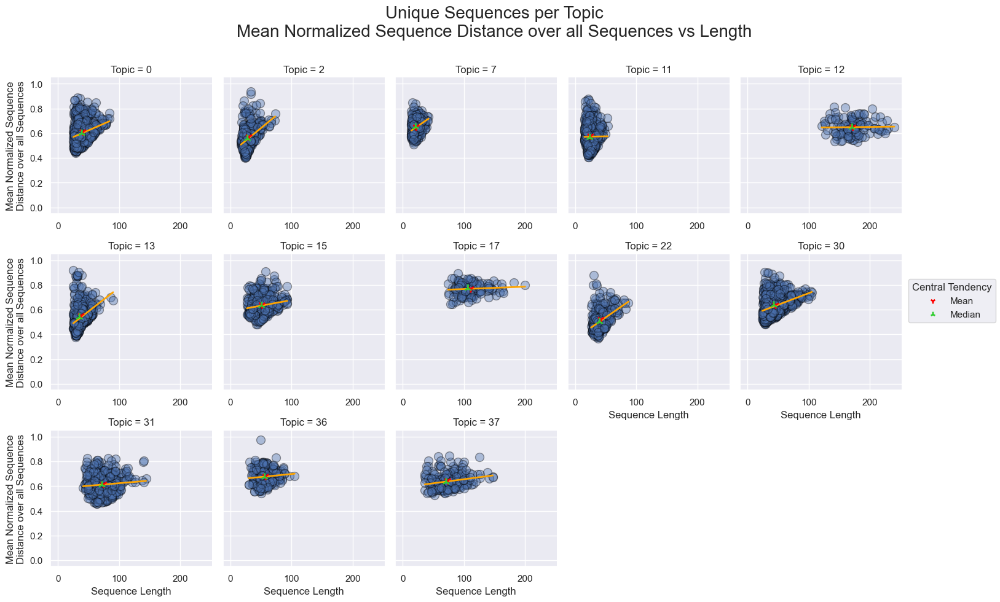

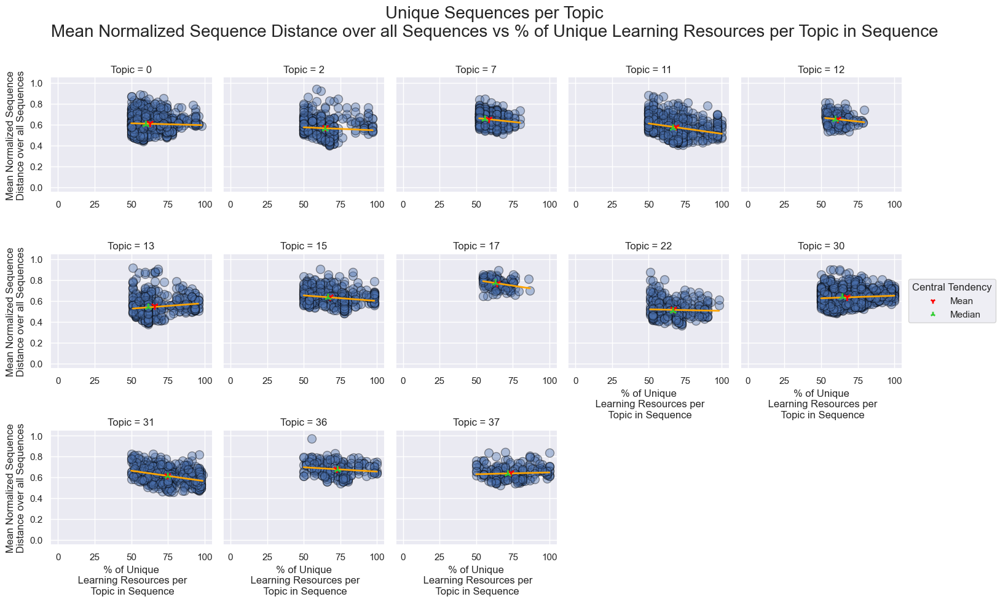

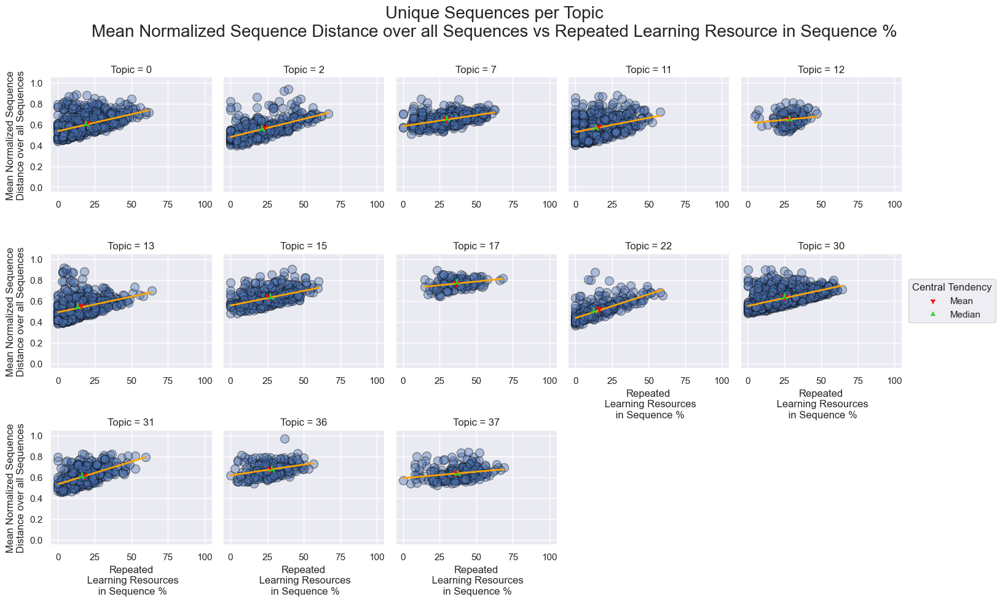

In [32]:
sequence_distance_analytics.plot_sequence_distances_per_sequence_per_group(SEQUENCE_DISTANCE_ANALYTICS_SEQUENCE_DIST_AVG_MEAN_NAME_STR,
                                                                           SEQUENCE_DISTANCE_ANALYTICS_SEQUENCE_DIST_BASE_ALL_SEQ_NAME_STR)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Normalized Sequence Distance Matrix per Topic:
 
Base: All User-Sequence Combinations
----------------------------------------------------------------------------------------------------


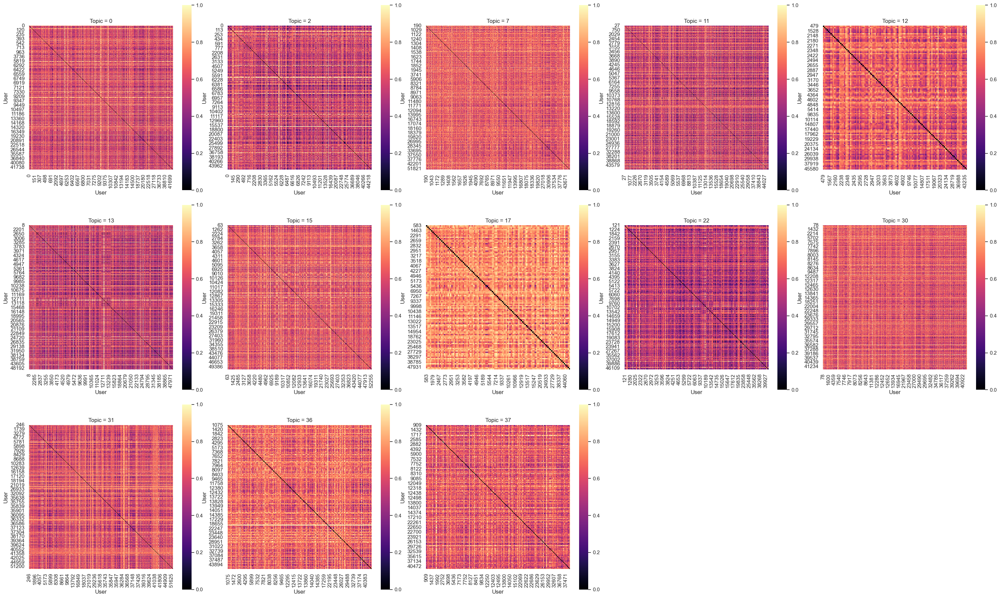

In [33]:
sequence_distance_analytics.plot_sequence_distance_matrix_per_group(True, 
                                                                    False,
                                                                    None,
                                                                    None)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Normalized Sequence Distance Matrix per Topic:
 
Base: All Unique-Sequence Combinations
----------------------------------------------------------------------------------------------------


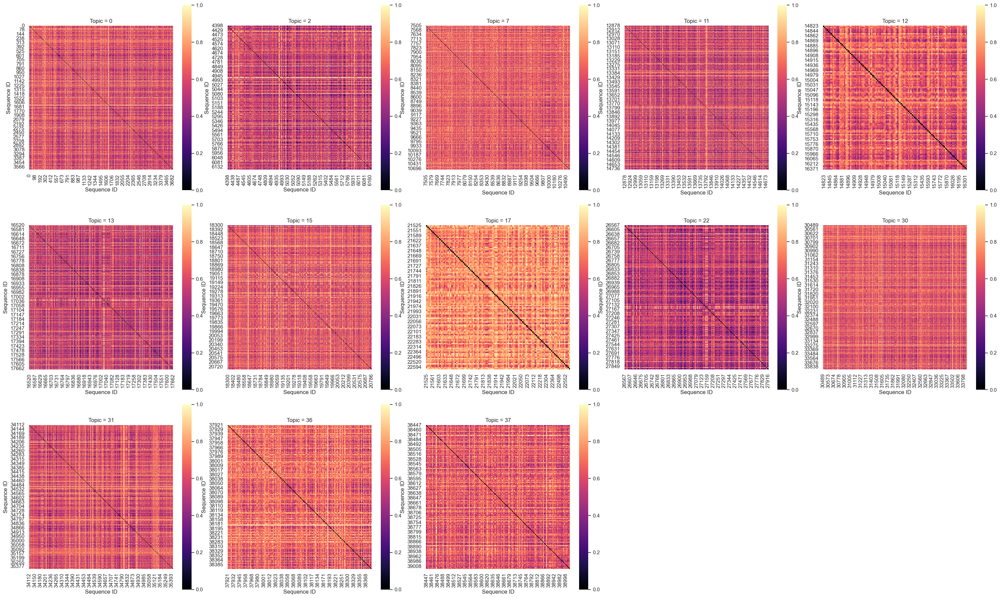

In [34]:
sequence_distance_analytics.plot_sequence_distance_matrix_per_group(True, 
                                                                    True,
                                                                    None,
                                                                    None)

## Clustering of Sequence Distances

In [35]:
sequence_distance_clusters = SequenceDistanceClustersPerGroup(DATASET_NAME,
                                                              False,
                                                              False,
                                                              sequence_distance_analytics,
                                                              cluster_algo,
                                                              dim_reduct_algo,
                                                              cluster_validation_functions,
                                                              HdbscanParaGrid,
                                                              UmapParaGrid,
                                                              cluster_validation_parameters,
                                                              cluster_validation_attributes,
                                                              PARALLELIZE_COMPUTATIONS)
sequence_distance_clusters.cluster_sequences_per_group()
sequence_distance_clusters.add_cluster_result_to_results_table(result_tables,
                                                               CLUSTERING_HDBSCAN_VALIDITY_INDEX_NAME_STR,
                                                               False)

In [36]:
pickle_write(sequence_distance_clusters,
             SEQUENCE_DISTANCE_CLUSTER_ANALYSIS_PICKLE_PATH_LIST,
             SEQUENCE_DISTANCE_CLUSTER_ANALYSIS_PICKLE_FULL_NAME,
             delete_old_files=DELETE_OLD_PICKLE_FILES)

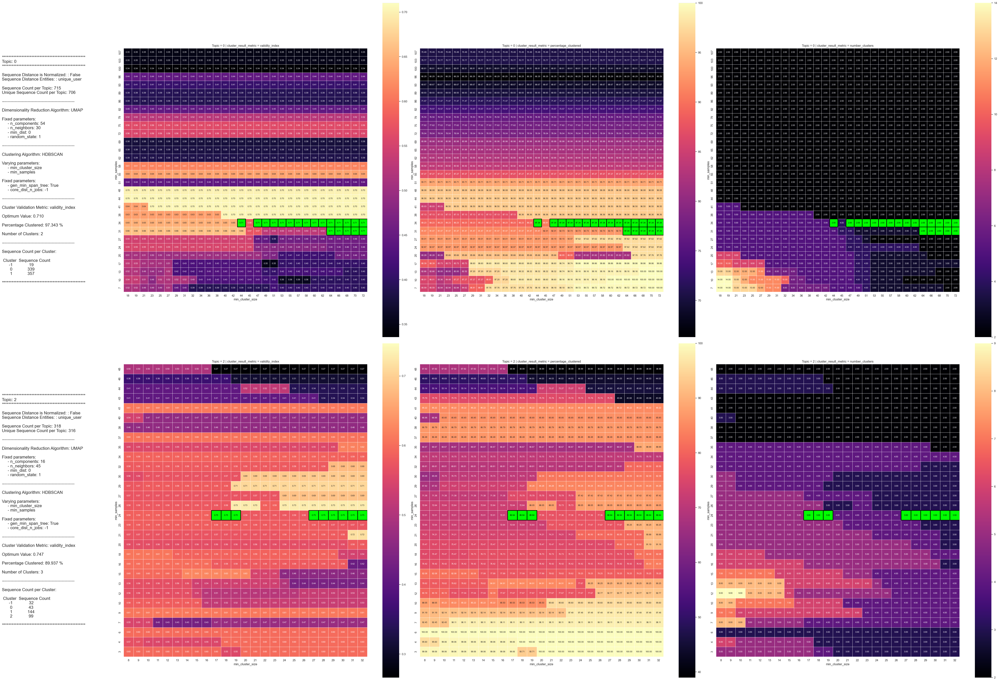

In [37]:
sequence_distance_clusters.plot_cluster_hyperparameter_tuning_matrix(CLUSTERING_HDBSCAN_MIN_CLUSTER_SIZE_NAME_STR,
                                                                     CLUSTERING_HDBSCAN_MIN_SAMPLES_NAME_STR,
                                                                     CLUSTERING_HDBSCAN_VALIDITY_INDEX_NAME_STR,
                                                                     False)

In [38]:
sequence_distance_clusters.plot_cluster_hyperparameter_tuning_parallel_coordinates(parallel_coordinates_param_list,
                                                                                   CLUSTERING_HDBSCAN_VALIDITY_INDEX_NAME_STR,
                                                                                   CLUSTERING_HDBSCAN_RELATIVE_VALIDITY_ATTRIBUTE_NAME_STR,
                                                                                   False,
                                                                                   True)

****************************************************************************************************
Parallel Coordinates Plots by Topic
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
    - Sequence Distance is Normalized: : False
    - Sequence Distance Entities: : unique_user
    - Cluster Validation Metric: validity_index
    - Lower values of validation metric are better: False
    - Only best embedding is selected: True
----------------------------------------------------------------------------------------------------


----------------------------------------------------------------------------------------------------
Topic: 0




----------------------------------------------------------------------------------------------------
Topic: 2


****************************************************************************************************
Clusters per Topic for best Hyperparameter Tuning Result
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
    - Dimensionality Reducer: UMAP
    - Unclustered sequences are colored black
    - Sequence Distance is Normalized: False
    - Sequence Distance Entities: unique_user
    - Cluster Validation Metric: validity_index
    - Lower values of validation metric are better: False
----------------------------------------------------------------------------------------------------


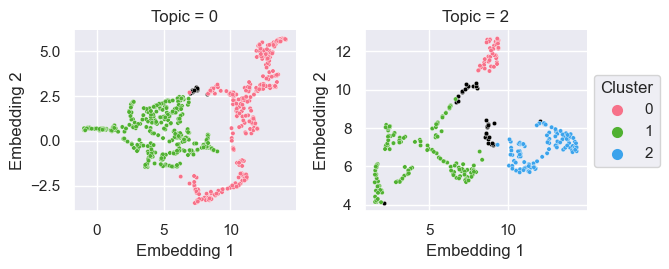

In [39]:
sequence_distance_clusters.plot_clusters_per_group_2d(CLUSTERING_HDBSCAN_VALIDITY_INDEX_NAME_STR,
                                                      False,
                                                      reducer_umap)

****************************************************************************************************
Clusters per Topic for best Hyperparameter Tuning Result
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
    - Dimensionality Reducer: PCA
    - Unclustered sequences are colored black
    - Sequence Distance is Normalized: False
    - Sequence Distance Entities: unique_user
    - Cluster Validation Metric: validity_index
    - Lower values of validation metric are better: False
----------------------------------------------------------------------------------------------------


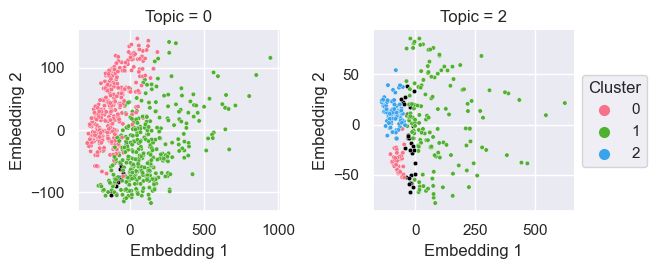

In [40]:
sequence_distance_clusters.plot_clusters_per_group_2d(CLUSTERING_HDBSCAN_VALIDITY_INDEX_NAME_STR,
                                                      False,
                                                      reducer_pca)

****************************************************************************************************
Cluster Statistics per Topic
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
    - Sequence Distance is Normalized: False
    - Sequence Distance Entities: unique_user
    - Cluster Validation Metric: validity_index
    - Lower values of validation metric are better: False
----------------------------------------------------------------------------------------------------


----------------------------------------------------------------------------------------------------
Number of Clusters


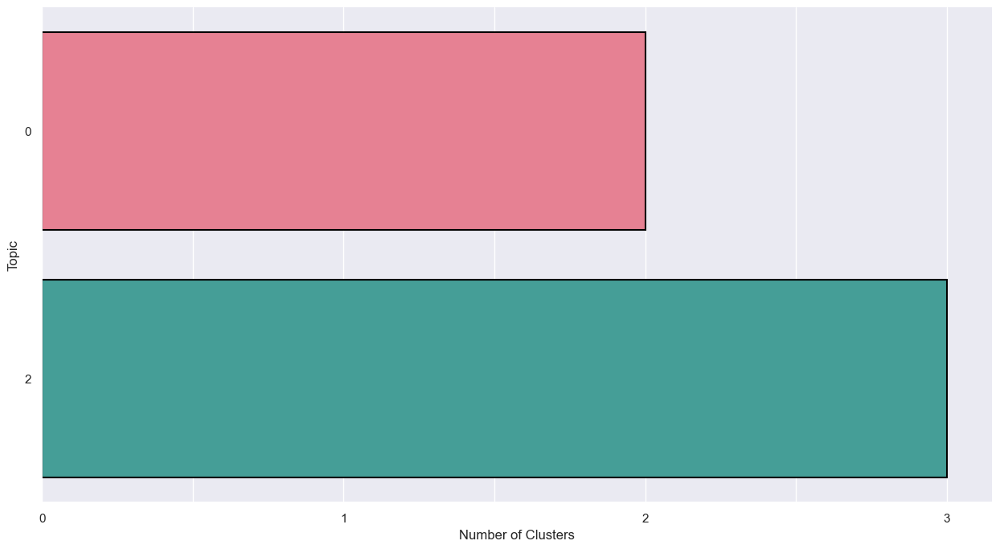

----------------------------------------------------------------------------------------------------
Percentage Clustered


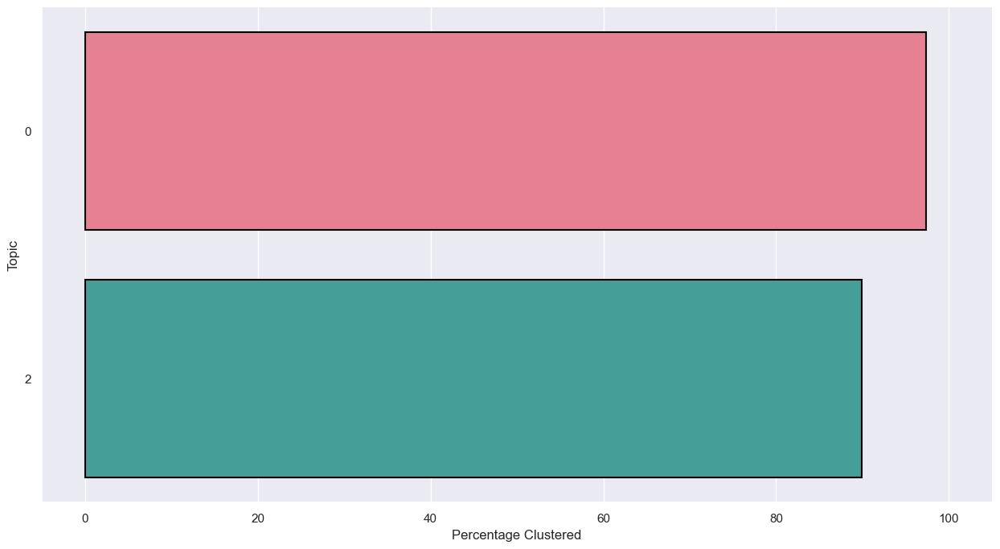

----------------------------------------------------------------------------------------------------
Smallest Cluster Size


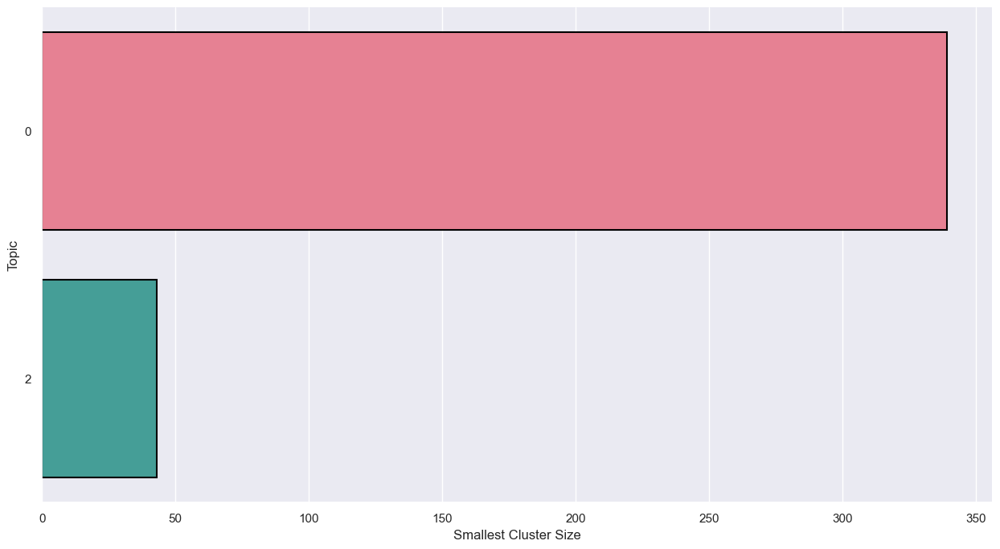

In [41]:
sequence_distance_clusters.plot_cluster_stats_per_group(CLUSTERING_HDBSCAN_VALIDITY_INDEX_NAME_STR,
                                                        False)

****************************************************************************************************
Number of Sequences per Cluster per Topic
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
    - Sequence Distance is Normalized: False
    - Sequence Distance Entities: unique_user
    - Cluster Validation Metric: validity_index
    - Lower values of validation metric are better: False
----------------------------------------------------------------------------------------------------


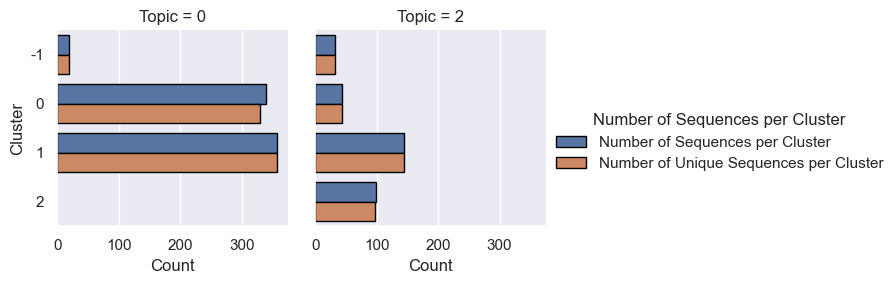

In [42]:
sequence_distance_clusters.plot_number_of_sequences_per_cluster_per_group(CLUSTERING_HDBSCAN_VALIDITY_INDEX_NAME_STR,
                                                                          False)

## Testing for Evaluation Metric Central Tendency Differences between Clusters

In [ ]:
ClusterAnalysisPlotGroupSelectionCriteria(DATASET_NAME,
                                          learning_activity_sequence_stats_per_group,
                                          seq_distances,
                                          True,
                                          50,
                                          5,
                                          (0.1, 0.9)).display_group_selection_criteria)

In [91]:
cluster_eval = ClusterEvaluation(DATASET_NAME, 
                                 interactions, 
                                 USER_FIELD_NAME_STR, 
                                 GROUP_FIELD_NAME_STR, 
                                 EVALUATION_GROUP_SCORE_HIGHEST_ALL_LEARNING_ACTIVITIES_MEAN_FIELD_NAME_STR,
                                 seq_distances,
                                 True,
                                 1,
                                 1,
                                 (0.01, 0.99),
                                 HDBSCAN,
                                 0.025,
                                 0.05,
                                 0.05,
                                 metric='precomputed',
                                 cluster_selection_method='eom')

In [21]:
import numpy as np
x = []
y = len(x) != 0
y

False

In [92]:
cluster_eval.cluster_sequences_and_test_eval_metric_diff()
cluster_eval.aggregate_sequence_clustering_and_eval_metric_diff_test_over_groups()

  0%|          | 0/13 [00:00<?, ?it/s]/opt/anaconda3/envs/DDIA/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/anaconda3/envs/DDIA/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
  0%|          | 0/13 [00:00<?, ?it/s]

[0.7755102  0.89795918 0.59183673 ... 0.75       0.68085106 0.42857143]
cluster labels: [-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

ValueError: zero-size array to reduction operation minimum which has no identity

In [ ]:
pickle_write(cluster_eval,
             PATH_TO_SEQUENCE_CLUSTER_EVALUATION_METRIC_ANALYSIS_PICKLE_FOLDER,
             DATASET_NAME + SEQUENCE_DISTANCE_CLUSTER_ANALYSIS_OBJECT_PICKLE_NAME)

In [ ]:
cluster_stats_per_group = cluster_eval.cluster_stats_per_group
cluster_eval_metric_central_tendency_differences_per_group = cluster_eval.cluster_eval_metric_central_tendency_differences_per_group
aggregate_sequence_clustering_and_eval_metric_diff_test = cluster_eval.aggregate_sequence_clustering_and_eval_metric_diff_test
group_cluster_analysis_inclusion_status = cluster_eval.group_cluster_analysis_inclusion_status
min_cluster_size_correction_df = cluster_eval.min_cluster_size_correction_df

In [ ]:
cluster_stats_per_group.head(1)

,Dataset Name,Topic,Number of Sequences,Number of Unique Sequences,Percentage Clustered,Cluster,Number of Sequences per Cluster,Number of Unique Sequences per Cluster,User,Sequence ID,Sequence Length,Sequence Array,Mean Evaluation Metric,Median Evaluation Metrice,Min Evaluation Metric Value,Max Evaluation Metric Value,STD Evaluation Metric Value,IQR Evaluation Metric Value
0,csedm_2021,0,500,142,74.4,-1,128,116,"[107, 108, 11, 111, 114, 116, 119, 120, 127, 1...","[2, 3, 4, 5, 6, 8, 10, 11, 13, 14, 15, 16, 17,...","[10, 11, 12, 12, 14, 14, 11, 2, 13, 13, 10, 10...","[(4, 5, 8, 6, 0, 1, 9, 2, 7, 3), (4, 5, 8, 7, ...",0.835129,0.889153,0.0,1.0,0.210356,0.197641


In [ ]:
cluster_eval_metric_central_tendency_differences_per_group.head(1)

,Dataset Name,Topic,Number of Sequences,Number of Unique Sequences,Mean Normalized Sequence Distance,Median Normalized Sequence Distance,Min Normalized Sequence Distance,Max Normalized Sequence Distance,STD Normalized Sequence Distance,IQR Normalized Sequence Distance,Clustering Algorithm,HDBSCAN Min Cluster Size,Number of Clusters,Percentage Clustered,Mean Cluster Size,Median Cluster Size,Min Cluster Size,Max Cluster Size,STD Cluster Size,IQR Cluster Size,Cluster Comparision Evaluation Metric,Normality Test Shapiro P-Value,Normality Test Jarque-Bera P-Value,Normality Test D'Agostion-Pearson P-Value,Homoscedasticity Test Levene P-Value,Homoscedasticity Test Bartlett P-Value,Central Tendency Differences Test Type,Central Tendency Differences Test P-Value
0,csedm_2021,0,500,142,0.208946,0.090909,0.0,1.0,0.239604,0.333333,HDBSCAN,12,4,74.4,93.0,28.0,22,294,116.150764,77.0,Topic Highest Score All Learning Resources Mean,1.714146e-28,0.0,6.679556e-48,6.781587e-40,2.209536e-164,kruskal_wallis_test,7.519329e-55


In [ ]:
aggregate_sequence_clustering_and_eval_metric_diff_test.head(1)

,Unfiltered Number of Topics,Number of Topics,Percentage of Unfiltered Topics,Number of Topics with Multiple Clusters,Mean Number of Sequences per Topic,Median Number of Sequences per Topic,Min Number of Sequences per Topic,Max Number of Sequences per Topic,STD Number of Sequences per Topic,IQR Number of Sequences per Topic,Mean Number of Unique Sequences per Topic,Median Number of Unique Sequences per Topic,Min Number of Unique Sequences per Topic,Max Number of Unique Sequences per Topic,STD Number of Unique Sequences per Topic,IQR Number of Unique Sequences per Topic,Mean Number of Clusters per Topic,Median Number of Clusters per Topic,Min Number of Clusters per Topic,Max Number of Clusters per Topic,STD Number of Clusters per Topic,IQR Number of Clusters per Topic,Mean Number of Sequences per Topic with Multiple Clusters,Median Number of Sequences per Topic with Multiple Clusters,Min Number of Sequences per Topic with Multiple Clusters,Max Number of Sequences per Topic with Multiple Clusters,STD Number of Sequences per Topic with Multiple Clusters,IQR Number of Sequences per Topic with Multiple Clusters,Mean Number of Unique Sequences per Topic with Multiple Clusters,Median Number of Unique Sequences per Topic with Multiple Clusters,Min Number of Unique Sequences per Topic with Multiple Clusters,Max Number of Unique Sequences per Topic with Multiple Clusters,STD Number of Unique Sequences per Topic with Multiple Clusters,IQR Number of Unique Sequences per Topic with Multiple Clusters,Mean Number of Clusters per Topic with Multiple Clusters,Median Number of Clusters per Topic with Multiple Clusters,Min Number of Clusters per Topic with Multiple Clusters,Max Number of Clusters per Topic with Multiple Clusters,STD Number of Clusters per Topic with Multiple Clusters,IQR Number of Clusters per Topic with Multiple Clusters,Number of Topics Significant Differeces Eval Metric Central Tendencies between Clusters,Percentage of Topics Significant Differeces Eval Metric Central Tendencies between Clusters,Percentage of Topics with Multiple Clusters Significant Differeces Eval Metric Central Tendencies between Clusters
Dataset Name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
csedm_2021,5,5,1.0,5,490.8,494.0,478,500,8.318654,6.0,235.6,238.0,142,308,69.255325,100.0,4.8,5.0,4,6,0.83666,1.0,490.8,494.0,478,500,8.318654,6.0,235.6,238.0,142,308,69.255325,100.0,4.8,5.0,4,6,0.83666,1.0,5,100.0,100.0


In [ ]:
group_cluster_analysis_inclusion_status.head(1)

,Dataset Name,Topic,Topic Included in Cluster Analysis,Minium Sequence Number Threshold Value,Minium Sequence Number Violated,Minium Unique Sequence Number Threshold Value,Minium Unique Sequence Number Violated,Sequence Distance Range Threshold Value,Sequence Distance Range Violated
0,csedm_2021,0,True,50,False,5,False,"(0.1, 0.9)",False


In [ ]:
min_cluster_size_correction_df.head(1)

,Dataset Name,Topic,Minimum Cluster Size Is Corrected,Uncorrected Minimum Cluster Size,Corrected Minimum Cluster Size
0,csedm_2021,0,False,12,12


****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Cluster Analysis - Included Topics
----------------------------------------------------------------------------------------------------
 
5 Topics out of 5 are included in Cluster Analysis:


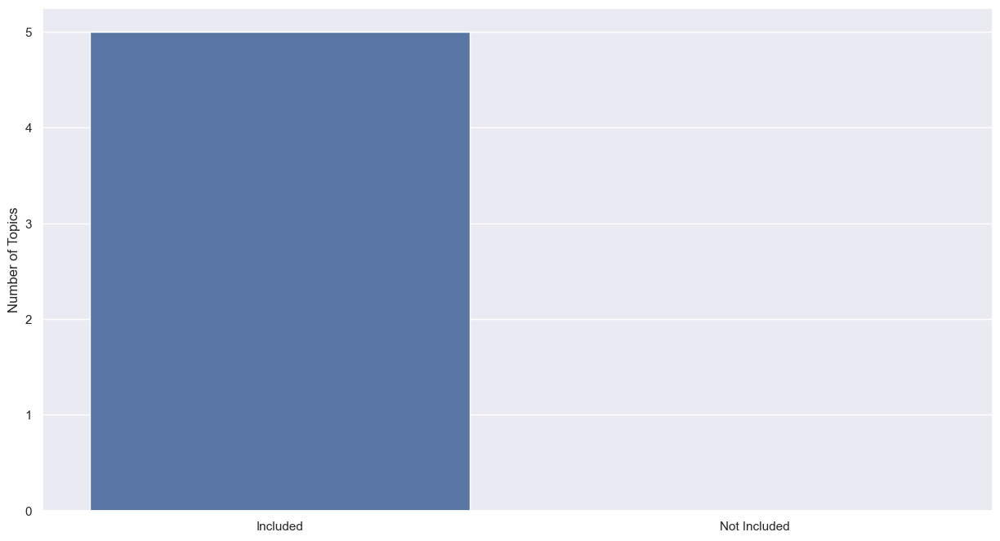

100.0% of Topics are included in Cluster Analysis:


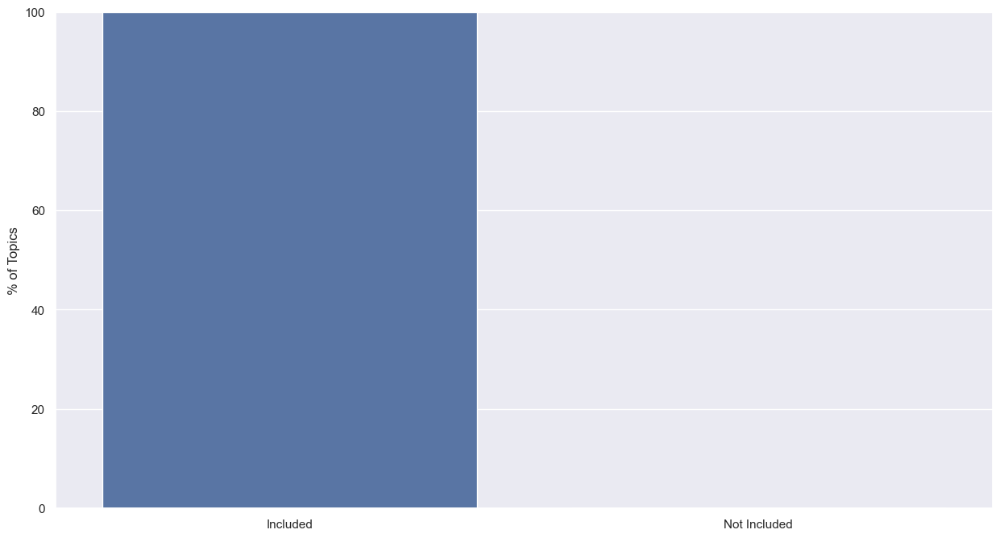

In [ ]:
cluster_eval.display_included_groups()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Clusters per Topic:
----------------------------------------------------------------------------------------------------


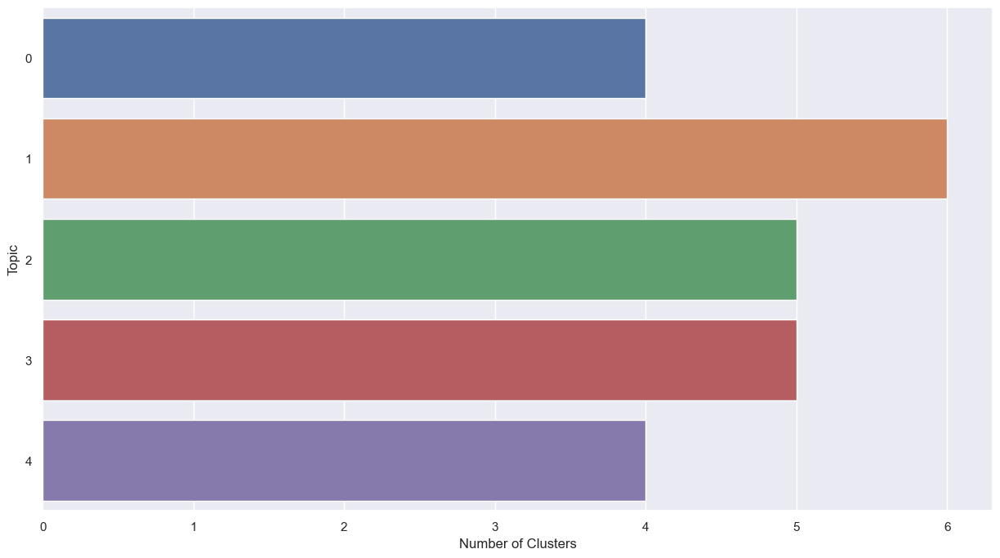

In [ ]:
cluster_eval.display_number_of_clusters_all_group()

In [ ]:
cluster_eval.print_number_of_clusters_all_group()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Clusters for each Topic:
----------------------------------------------------------------------------------------------------
Topic  Number of Clusters
    0                   4
    4                   4
    2                   5
    3                   5
    1                   6


****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Min Cluster Size per Topic:
----------------------------------------------------------------------------------------------------


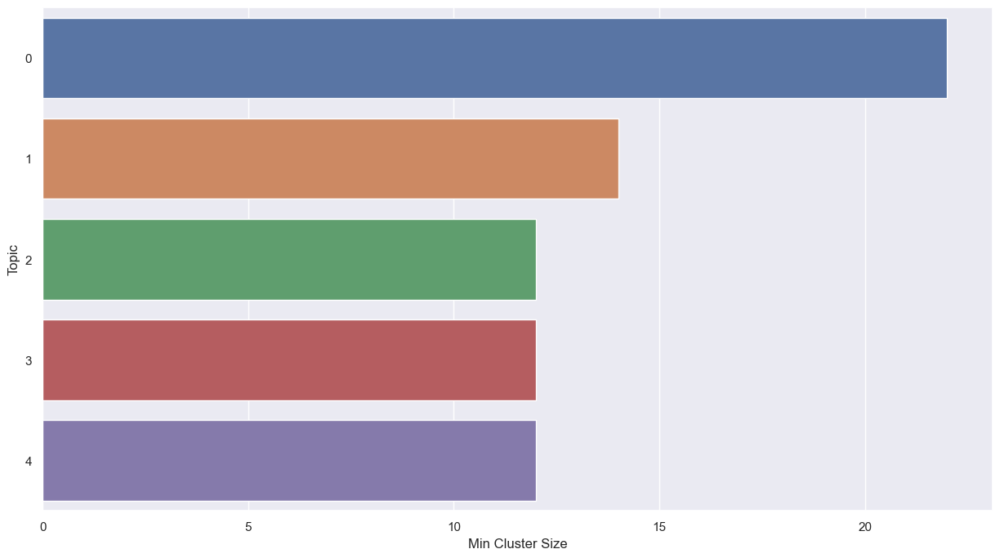

In [ ]:
cluster_eval.display_min_cluster_size_all_group()

In [ ]:
cluster_eval.print_min_cluster_sizes_all_group()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Min Cluster Size per Topic:
----------------------------------------------------------------------------------------------------
Topic  Min Cluster Size
    2                12
    3                12
    4                12
    1                14
    0                22


****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Percentage Clustered per Topic:
----------------------------------------------------------------------------------------------------


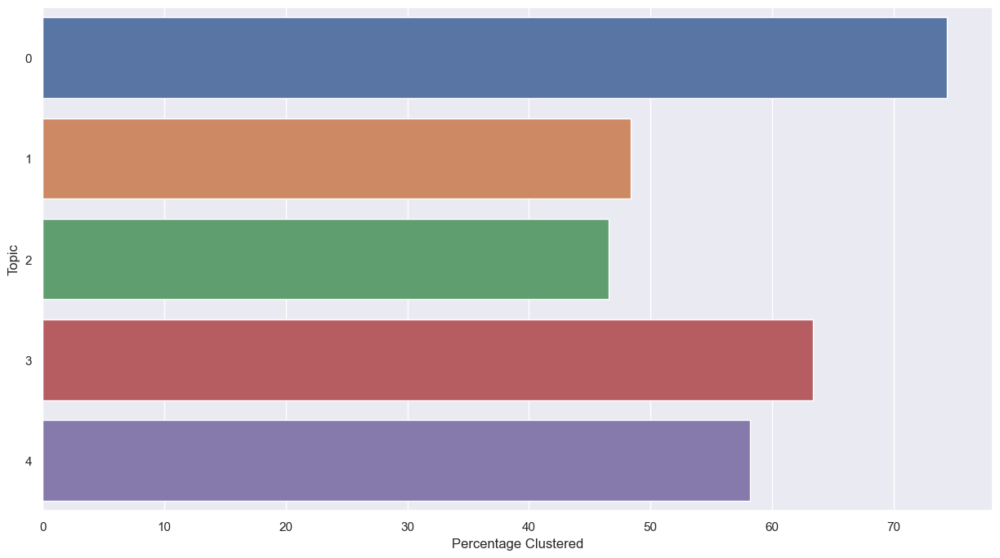

In [ ]:
cluster_eval.display_percentage_clustered_all_group()

In [ ]:
cluster_eval.print_percentage_clustered_all_group()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Percentage Clustered per Topic:
----------------------------------------------------------------------------------------------------
Topic  Percentage Clustered
    2             46.558704
    1             48.380567
    4             58.158996
    3             63.319672
    0             74.400000


****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Sequences per Cluster for each Topic:
----------------------------------------------------------------------------------------------------
Plots:


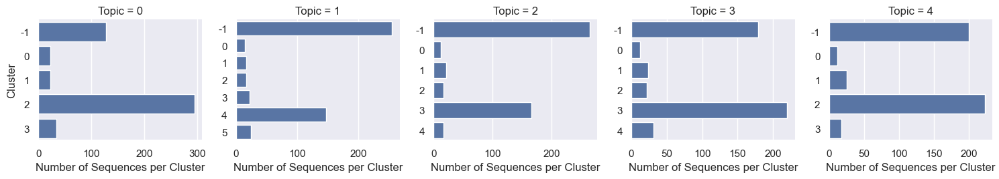

In [ ]:
cluster_eval.display_number_sequences_per_cluster_all_group(height=3)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Sequences per Cluster for each Topic:
----------------------------------------------------------------------------------------------------
Plots:


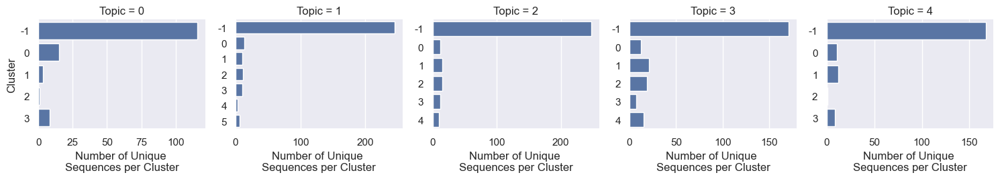

In [ ]:
cluster_eval.display_number_unique_sequences_per_cluster_all_group(height=3)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Sequences vs Number of Sequences per Cluster for each Topic:
----------------------------------------------------------------------------------------------------
Plots:


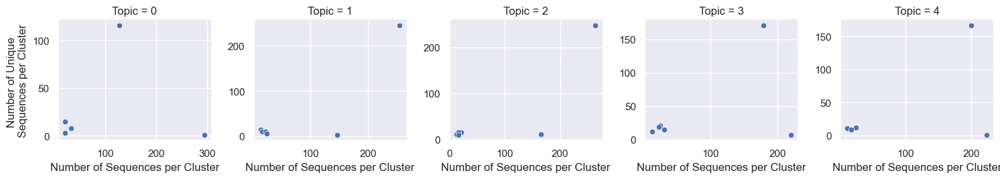

In [ ]:
cluster_eval.display_number_unique_sequences_vs_number_sequences_per_cluster_all_group(height=3)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Central Tendency Differences in Evaluation Metric between Clusters per Topic:
Chosen Evaluation Metric: "Topic Highest Score All Learning Resources Mean"
----------------------------------------------------------------------------------------------------


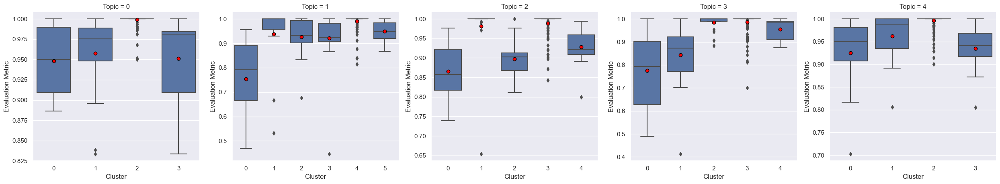

In [ ]:
cluster_eval.display_eval_metric_dist_between_cluster_all_groups(height=5)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Clusters per Topic
Dimensionality Reducer: UMAP
----------------------------------------------------------------------------------------------------


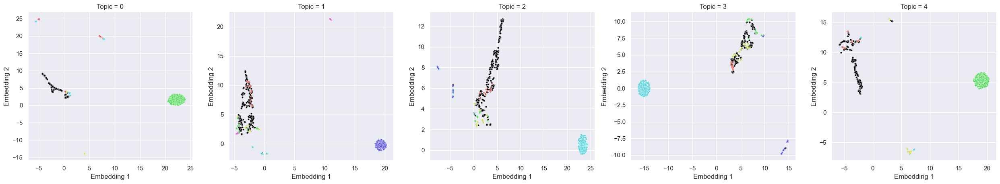

In [ ]:
cluster_eval.display_clusters_all_group_umap(height=5)

## Object Size

In [35]:
return_object_size(DATASET_NAME,
                   globals(),
                   result_tables).head(20)

,Dataset Name,Object,Size in MB
0,kdd_2015,import_interactions,1000.066664
1,kdd_2015,transform_interactions,501.998593
2,kdd_2015,sequence_distance_analytics,179.050463
3,kdd_2015,result_tables,178.542842
4,kdd_2015,sequence_statistics,177.650734
5,kdd_2015,interactions,169.245624
6,kdd_2015,sequence_filter,76.505980
7,kdd_2015,value_mapping_df,10.460576
8,kdd_2015,_ih,0.010000
9,kdd_2015,_dh,0.001656


## Save ResultTables

In [39]:
pickle_write(result_tables,
             RESULT_TABLES_PICKLE_PATH_LIST,
             RESULT_TABLES_PICKLE_FULL_NAME,
             delete_old_files=DELETE_OLD_PICKLE_FILES)